#  ReneWind project

## INDEX

1.IMPORTING LIBRARIES

2.LOADING DATA

3.EDA

3.1 UNIVARIATE ANALYSIS/ EDA ON TRAIN DATA

3.2 UNIVARIATE ANALYSIS/ EDA ON TEST DATA

3.3 BIVARIATE ANALYSIS FOR TRAIN DATA

4.CHECKING FOR OUTLIERS AND OUTLIER TREATMENT

4.1 MODEL BUILDING WITH OUTLIER TREATMENT

5.DATA PRE-PROCESSING

5.1 TREATING MISSING VALUES ON DATA FRAME WITHOUT OUTLIER TREATMENT

A. METHOD 1: IMPUTING DATA WITH SIMPLE IMPUTER

B. METHOD2: IMPUTING DATA WITH KNN IMPUTER

6. MODEL BUILDING

6.1 MODEL BUILDING WITH ORIGINAL DATA

MODEL BUILDING WITH ORIGINAL DATA WITH METHOD1, SIMPLE IMPUTER (X_TRAIN)

6.2 MODEL BUILDING WITH ORIGINAL DATA USING METHOD2, KNN IMPUTER (X_TRAIN2)

6.3 MODEL BUILDING WITH OVERSAMPLED DATA

6.4 MODEL BUILDING WITH UNDERSAMPLED DATA

6.5 CHOOSING THE THREE BEST MODELS

7. HYPERPARAMETERTUNING

A. TUNING METHOD FOR XGBOSSTER WITH OVERSAMPLED DATA

B. TUNING RANDOMFOREST WITH OVERSAMPLED DATA

C.TUNING BAGGING MODEL WITH OVERSAMPLED DATA

D.TUNING GRADIENT BOOSTING WITH OVERSAMPLED DATA

E. LOGISTIC REGRESSION WITH L2 REGULARIZATION IN OVERSAMPLED DATA

8.MODEL PERFORMANCE COMPARISON AND CHOOSING THE FINAL MODEL


9.TEST SET FINAL PERFORMANCE

10 PIPELINES TO BUILD THE FINAL MODEL

11 FINAL MODEL

12.BUSINESS INSIGHTS AND CONCLUSIONS



## ReneWind 

Renewable energy sources play an increasingly important role in the global energy mix, as the effort to reduce the environmental impact of energy production increases.

Out of all the renewable energy alternatives, wind energy is one of the most developed technologies worldwide. The U.S Department of Energy has put together a guide to achieving operational efficiency using predictive maintenance practices.

Predictive maintenance uses sensor information and analysis methods to measure and predict degradation and future component capability. The idea behind predictive maintenance is that failure patterns are predictable and if component failure can be predicted accurately and the component is replaced before it fails, the costs of operation and maintenance will be much lower.

The sensors fitted across different machines involved in the process of energy generation collect data related to various environmental factors (temperature, humidity, wind speed, etc.) and additional features related to various parts of the wind turbine (gearbox, tower, blades, break, etc.). 



## Objective
“ReneWind” is a company working on improving the machinery/processes involved in the production of wind energy using machine learning and has collected data of generator failure of wind turbines using sensors. They have shared a ciphered version of the data, as the data collected through sensors is confidential (the type of data collected varies with companies). Data has 40 predictors, 40000 observations in the training set and 10000 in the test set.

The objective is to build various classification models, tune them, and find the best one that will help identify failures so that the generator could be repaired before failing/breaking to reduce the maintenance cost. The different costs associated with maintenance are as follows:

- `Replacement cost = $40,000`
- `Repair cost = $15,000`
- `Inspection cost = $5,000`

“1” in the target variables should be considered as “failure” and “0” will represent “No failure”.

## Data Description
- The data provided is a transformed version of original data which was collected using sensors.
- Train.csv - To be used for training and tuning of models. 
- Test.csv - To be used only for testing the performance of the final best model.
- Both the datasets consist of 40 predictor variables and 1 target variable

## 1.Importing libraries

In [150]:

# Libraries to  manipulating data
import pandas as pd
import numpy as np

# to help visualization

import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
#to import metrics fro sklearn
from sklearn import metrics
# To compare models performance 
from sklearn.metrics import (
    f1_score,
    accuracy_score,
    recall_score,
    precision_score,
    confusion_matrix,
    plot_confusion_matrix,
)
#to devide the data sets in train, test and validation set 

from sklearn.model_selection import train_test_split
#to perform cross validation
from sklearn.model_selection import StratifiedKFold, cross_val_score

# To be used for data scaling and one hot encoding
from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder

# To impute null values in dataset
from sklearn.impute import SimpleImputer
from sklearn.impute import KNNImputer

# To oversample and undersample data
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

# To tune models with  hyperparameter search
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV

# To be used pipelines for process standarization
from sklearn.pipeline import Pipeline
from sklearn.pipeline import make_pipeline
from sklearn.compose import ColumnTransformer

# To build the models
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import (
    AdaBoostClassifier,
    GradientBoostingClassifier,
    RandomForestClassifier,
    BaggingClassifier,
)
from xgboost import XGBClassifier

# To suppress warning messages
import warnings

warnings.filterwarnings("ignore")

In [2]:

# To supress scientific notations for a dataframe
pd.set_option("display.float_format", lambda x: "%.3f" % x)

# To suppress scientific notations
pd.set_option("display.float_format", lambda x: "%.3f" % x)

In [3]:

# To set maximum number of columns and rows 
pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", 200)


## 2.Loading Data

In [4]:
#loading the training and validation database
data_train_val=pd.read_csv(r'C:\Users\charo\Downloads\Train.csv')
#loading the testing data
data_test=pd.read_csv(r'C:\Users\charo\Downloads\Test.csv')

**CHECKING TRAIN DATA**

In [5]:
#checning the dataset, five first rows
data_train_val.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
0,-4.465,-4.679,3.102,0.506,-0.221,-2.033,-2.911,0.051,-1.522,3.762,-5.715,0.736,0.981,1.418,-3.376,-3.047,0.306,2.914,2.270,4.395,-2.388,0.646,-1.191,3.133,0.665,-2.511,-0.037,0.726,-3.982,-1.073,1.667,3.060,-1.690,2.846,2.235,6.667,0.444,-2.369,2.951,-3.480,0
1,-2.910,-2.569,4.109,1.317,-1.621,-3.827,-1.617,0.669,0.387,0.854,-6.353,4.272,3.162,0.258,-3.547,-4.285,2.897,1.508,3.668,7.124,-4.096,1.015,-0.970,-0.968,2.064,-1.646,0.427,0.735,-4.470,-2.772,-2.505,-3.783,-6.823,4.909,0.482,5.338,2.381,-3.128,3.527,-3.020,0
2,4.284,5.105,6.092,2.640,-1.041,1.308,-1.876,-9.582,3.470,0.763,-2.573,-3.350,-0.595,-5.247,-4.310,-16.232,-1.000,2.318,5.942,-3.858,-11.599,4.021,-6.281,4.633,0.930,6.280,0.851,0.269,-2.206,-1.329,-2.399,-3.098,2.690,-1.643,7.566,-3.198,-3.496,8.105,0.562,-4.227,0
3,3.366,3.653,0.910,-1.368,0.332,2.359,0.733,-4.332,0.566,-0.101,1.914,-0.951,-1.255,-2.707,0.193,-4.769,-2.205,0.908,0.757,-5.834,-3.065,1.597,-1.757,1.766,-0.267,3.625,1.500,-0.586,0.783,-0.201,0.025,-1.795,3.033,-2.468,1.895,-2.298,-1.731,5.909,-0.386,0.616,0
4,-3.832,-5.824,0.634,-2.419,-1.774,1.017,-2.099,-3.173,-2.082,5.393,-0.771,1.107,1.144,0.943,-3.164,-4.248,-4.039,3.689,3.311,1.059,-2.143,1.650,-1.661,1.680,-0.451,-4.551,3.739,1.134,-2.034,0.841,-1.600,-0.257,0.804,4.086,2.292,5.361,0.352,2.940,3.839,-4.309,0


In [6]:
#checning the dataset, five last rows
data_train_val.tail()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
39995,-3.897,-3.942,-0.351,-2.417,1.108,-1.528,-3.520,2.055,-0.234,-0.358,-3.782,2.180,6.112,1.985,-8.330,-1.639,-0.915,5.672,-3.924,2.133,-4.502,2.777,5.728,1.620,-1.700,-0.042,-2.923,-2.760,-2.254,2.552,0.982,7.112,1.476,-3.954,1.856,5.029,2.083,-6.409,1.477,-0.874,0
39996,-3.187,-10.052,5.696,-4.370,-5.355,-1.873,-3.947,0.679,-2.389,5.457,1.583,3.571,9.227,2.554,-7.039,-0.994,-9.665,1.155,3.877,3.524,-7.015,-0.132,-3.446,-4.801,-0.876,-3.812,5.422,-3.732,0.609,5.256,1.915,0.403,3.164,3.752,8.530,8.451,0.204,-7.130,4.249,-6.112,0
39997,-2.687,1.961,6.137,2.600,2.657,-4.291,-2.344,0.974,-1.027,0.497,-9.589,3.177,1.055,-1.416,-4.669,-5.405,3.720,2.893,2.329,1.458,-6.429,1.818,0.806,7.786,0.331,5.257,-4.867,-0.819,-5.667,-2.861,4.674,6.621,-1.989,-1.349,3.952,5.450,-0.455,-2.202,1.678,-1.974,0
39998,0.521,0.096,8.457,2.138,-1.636,-2.713,-2.693,-3.410,1.936,2.012,-4.989,-0.819,4.166,-1.192,-5.033,-8.523,-1.950,0.017,4.505,2.031,-8.849,0.566,-6.040,-0.043,1.656,4.250,1.727,-1.686,-3.963,-2.642,1.939,-1.257,-1.136,1.434,5.905,3.752,-1.867,-1.918,2.573,-5.019,0
39999,2.403,-1.336,6.451,-5.356,-0.434,0.255,-1.120,-2.523,-0.654,2.316,-2.862,0.199,1.593,-0.337,-0.709,-4.408,-3.683,2.973,-1.223,-1.958,-4.454,0.464,-4.952,-1.624,2.965,2.009,5.712,-2.910,-2.287,-3.676,5.678,-4.310,-0.709,-1.359,1.639,7.766,-0.245,-1.124,2.872,1.902,0


In [7]:
#Checking testing dataframe, five random rows
data_test.sample(5)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
5168,5.451,0.978,9.572,3.722,-4.462,-4.081,-2.328,-2.391,5.374,-1.530,-4.872,-1.369,5.173,-1.717,-4.141,-10.348,1.308,-2.061,4.914,6.230,-11.603,1.226,-6.919,-5.190,4.317,3.379,2.334,-1.751,-2.910,-2.562,-1.523,-7.495,-4.993,1.359,6.653,-0.107,-0.987,-6.039,0.485,-3.709,0
6706,-1.585,-3.318,-0.813,-3.732,-0.865,-1.345,-2.706,0.692,2.531,-3.147,-3.433,3.969,8.049,1.142,-8.858,-4.839,0.867,6.473,-4.427,4.757,-6.216,4.165,5.657,-4.076,0.335,-1.272,-0.461,-2.591,-2.245,1.109,-4.985,-2.380,-3.217,-2.716,-1.022,3.778,4.764,-6.218,2.333,0.656,0
7757,-5.465,-4.516,0.051,1.559,-1.716,0.836,-0.686,-0.608,-4.415,5.735,3.096,0.650,-3.125,0.136,1.654,2.440,-3.277,-1.607,6.859,0.388,3.014,-2.282,-3.670,3.623,-2.422,-4.756,0.165,2.805,2.583,4.241,-0.204,2.837,4.417,6.452,3.883,0.963,-1.652,4.548,1.496,-5.066,0
8858,-3.482,-1.394,1.710,-2.401,0.812,0.866,-4.709,-5.203,3.301,-1.360,-4.105,-0.795,6.973,-0.846,-11.759,-10.838,-1.656,8.405,-3.670,1.063,-8.722,3.813,0.938,-0.396,-0.963,2.922,-1.573,-2.852,-2.331,0.944,-3.525,-0.100,2.441,-4.533,1.456,3.645,2.217,-1.061,3.427,-1.798,0
2842,6.265,-0.825,2.690,-5.168,-1.380,-0.958,1.107,2.176,0.466,-0.311,0.504,1.047,3.928,1.832,1.403,2.125,-3.656,-1.110,-3.545,-1.637,-2.153,0.375,0.051,-5.656,2.756,1.225,6.257,-3.888,-1.398,-2.793,5.222,-2.940,-2.804,-2.584,-0.013,3.846,-0.024,-6.146,-0.177,3.329,0


In [8]:
#We create a copy of the dataset
df=data_train_val.copy()

In [9]:
#Checking dataframe 
df.sample(10).T

,38352,18930,6940,34959,15444,38298,24852,9950,39386,38293
V1,3.315,-2.298,4.848,0.136,3.869,-1.201,1.888,2.987,9.903,-4.327
V2,1.055,0.124,6.584,-0.631,2.341,1.617,0.091,-1.379,4.403,2.042
V3,6.483,3.246,5.204,0.223,3.832,0.213,8.495,5.645,6.289,-5.120
V4,-2.635,1.905,3.528,-3.094,4.537,-1.938,-2.724,-0.879,-4.028,0.828
V5,-1.209,1.652,-1.087,0.465,-1.324,1.498,-0.427,-2.954,-3.387,3.434
V6,0.149,-2.174,1.089,-0.067,-5.200,1.063,-1.613,-1.092,1.752,3.317
V7,-0.482,0.012,-0.532,1.217,0.197,0.128,-0.811,-2.004,1.716,0.007
V8,-2.721,4.408,-8.292,3.141,2.177,0.982,-0.961,-2.546,-6.588,-2.486
V9,0.397,-5.849,3.156,-3.786,2.470,-1.524,-0.543,1.391,0.804,-1.782
V10,0.688,2.805,-0.051,-0.079,-1.422,-2.271,1.583,2.045,0.996,-0.297


In [10]:
#Checking the shape of the data frame.
df.shape

(40000, 41)

In [11]:
print (f'This data frame contains {df.shape[0]} rows and {df.shape[1]} columns')

This data frame contains 40000 rows and 41 columns


In [12]:
#Looking for duplicated values. There are not duplicates.
df.duplicated().any()

False

In [13]:
#looking for missing values. showing only variables with missing values.
df.isnull().sum().sort_values(ascending=False).head(5)

V1     46
V2     39
V40     0
V30     0
V23     0
dtype: int64

- From the data set we can see that we have two variables with missing values, V1 and V2. This is a problem that we will have to address later on.

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40000 entries, 0 to 39999
Data columns (total 41 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   V1      39954 non-null  float64
 1   V2      39961 non-null  float64
 2   V3      40000 non-null  float64
 3   V4      40000 non-null  float64
 4   V5      40000 non-null  float64
 5   V6      40000 non-null  float64
 6   V7      40000 non-null  float64
 7   V8      40000 non-null  float64
 8   V9      40000 non-null  float64
 9   V10     40000 non-null  float64
 10  V11     40000 non-null  float64
 11  V12     40000 non-null  float64
 12  V13     40000 non-null  float64
 13  V14     40000 non-null  float64
 14  V15     40000 non-null  float64
 15  V16     40000 non-null  float64
 16  V17     40000 non-null  float64
 17  V18     40000 non-null  float64
 18  V19     40000 non-null  float64
 19  V20     40000 non-null  float64
 20  V21     40000 non-null  float64
 21  V22     40000 non-null  float64
 22

- All variables data type are numeric, float or integer in the case of the target variable, so we do not have to transform them for now in order to complete the EDA analysis. Again, variable 1 and 2 are showing some null values.

**CHECKING TEST DATA**

In [15]:
#making a copy of the test database
df_test=data_test.copy()

In [16]:
# let's check if the same null values appear on the test set.
df_test.isnull().sum().sort_values(ascending=False).head(2)

V1    11
V2     7
dtype: int64

- It seems that we need to also fix some null values on test data.

In [17]:
#looking for duplicate data on test dataset
data_test.duplicated().sum()

0

In [18]:
#checking data test size
df_test.shape

(10000, 41)

In [19]:
print (f'Test data frame contains {df_test.shape[0]} rows and {df_test.shape[1]} columns')

Test data frame contains 10000 rows and 41 columns


In [20]:
#Checking columns on test set
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 41 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   V1      9989 non-null   float64
 1   V2      9993 non-null   float64
 2   V3      10000 non-null  float64
 3   V4      10000 non-null  float64
 4   V5      10000 non-null  float64
 5   V6      10000 non-null  float64
 6   V7      10000 non-null  float64
 7   V8      10000 non-null  float64
 8   V9      10000 non-null  float64
 9   V10     10000 non-null  float64
 10  V11     10000 non-null  float64
 11  V12     10000 non-null  float64
 12  V13     10000 non-null  float64
 13  V14     10000 non-null  float64
 14  V15     10000 non-null  float64
 15  V16     10000 non-null  float64
 16  V17     10000 non-null  float64
 17  V18     10000 non-null  float64
 18  V19     10000 non-null  float64
 19  V20     10000 non-null  float64
 20  V21     10000 non-null  float64
 21  V22     10000 non-null  float64
 22 

- As in the train set, we count with 40 columns and all of the vairables are numeric.

## 3.EDA

### 3.1 UNIVARIATE ANALYSIS/ EDA ON TRAIN DATA

In [108]:
#checking the summary of variables on dataset
df.describe().T

,count,mean,std,min,25%,50%,75%,max
V1,39954.000,-0.288,3.449,-13.502,-2.751,-0.774,1.837,17.437
V2,39961.000,0.443,3.139,-13.212,-1.638,0.464,2.538,13.089
V3,40000.000,2.506,3.406,-11.469,0.203,2.265,4.585,18.366
V4,40000.000,-0.066,3.437,-16.015,-2.350,-0.124,2.149,13.280
V5,40000.000,-0.045,2.107,-8.613,-1.507,-0.097,1.346,9.403
V6,40000.000,-1.001,2.037,-10.227,-2.363,-1.007,0.374,7.065
V7,40000.000,-0.893,1.757,-8.206,-2.037,-0.935,0.207,8.006
V8,40000.000,-0.563,3.299,-15.658,-2.660,-0.384,1.714,11.679
V9,40000.000,-0.008,2.162,-8.596,-1.494,-0.052,1.426,8.507
V10,40000.000,-0.002,2.183,-11.001,-1.391,0.106,1.486,8.108


- As we can see the variables are given a cyphered names and description, so we are unable to know exactly what each of them is referring to. 
Except for the target (failure or not) that is a discrete variable, the predictors contain continues values.
- V1 and V2 are the only two variables that contains missing values in the dataset.
- Most of the variables seem to have outliers, especially in the upper extreme values.
- Let's check the statistical summary along with the histogram and boxplot below in order to have a better understanding of the variables behavior, since we are not given any additional information.


**Target on Train set**

- Target variable is a discrete variable with only two values so we can try to check how many values of each class contains.

In [109]:
df['Target'].value_counts(normalize=True)*100

0   94.532
1    5.468
Name: Target, dtype: float64

- The target variable is certainly imbalanced since we only have 5.5 per cent of the class 1 variable (generator failure).We will have to treat the data so the model we built to classify the generator issues in not biased tower the dominant class, that is 0 in this case.

#### 3.1.2 Plotting histograms and boxplots for all the variables on train data

In [110]:
# function to plot a boxplot and a histogram along the same scale.


def histogram_boxplot(data, feature, figsize=(12, 7), kde=False, bins=None):
    """
    Boxplot and histogram combined

    data: dataframe
    feature: dataframe column
    figsize: size of figure (default (12,7))
    kde: whether to the show density curve (default False)
    bins: number of bins for histogram (default None)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(
        nrows=2,  # Number of rows of the subplot grid= 2
        sharex=True,  # x-axis will be shared among all subplots
        gridspec_kw={"height_ratios": (0.25, 0.75)},
        figsize=figsize,
    )  # creating the 2 subplots
    sns.boxplot(
        data=data, x=feature, ax=ax_box2, showmeans=True, color="yellow"
    )  # boxplot will be created and a star will indicate the mean value of the column
    sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2, bins=bins,color='Darkblue'
    ) if bins else sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2,color='Purple' 
    )  # For histogram
    ax_hist2.axvline(
        data[feature].mean(), color="yellow", linestyle="-", linewidth=3
    )  # Add mean to the histogram
    ax_hist2.axvline(
        data[feature].median(), color="red", linestyle="--", linewidth=3
    )  # Add median to the histogram

#### A.Plotting all the features on predictors train data

In [111]:
#creating list to feed the histogram boxplot function on continues variables.
feature_list=['V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11',
       'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21',
       'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31',
       'V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'V38', 'V39', 'V40']

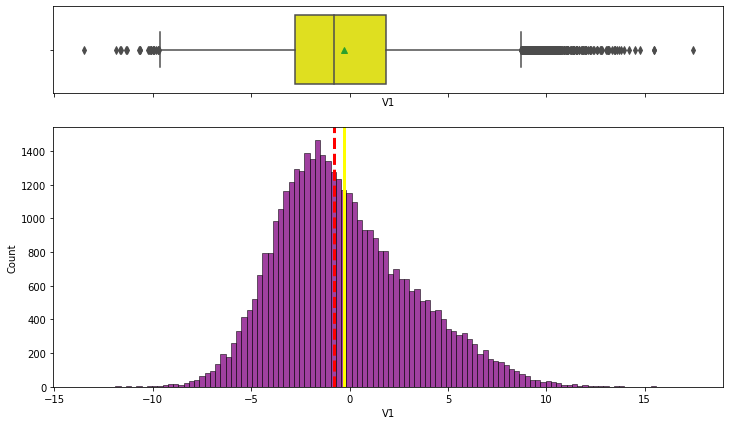

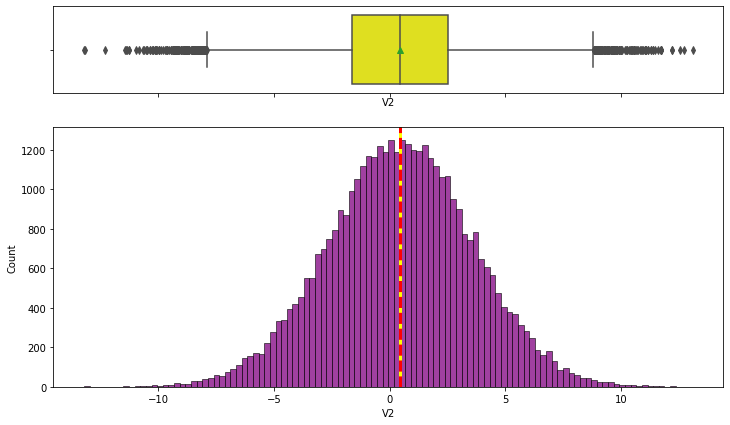

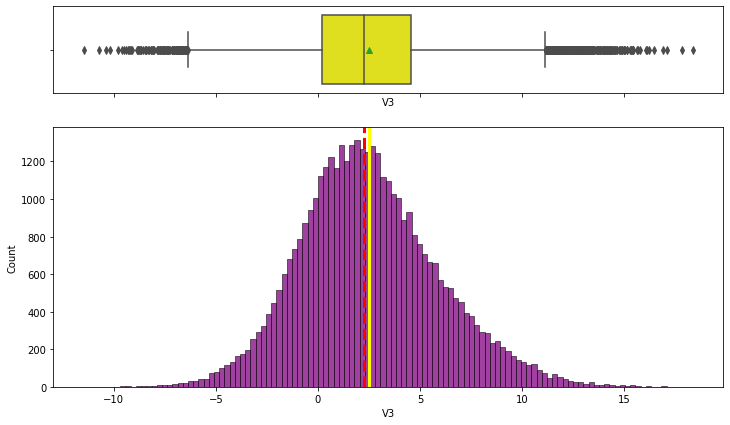

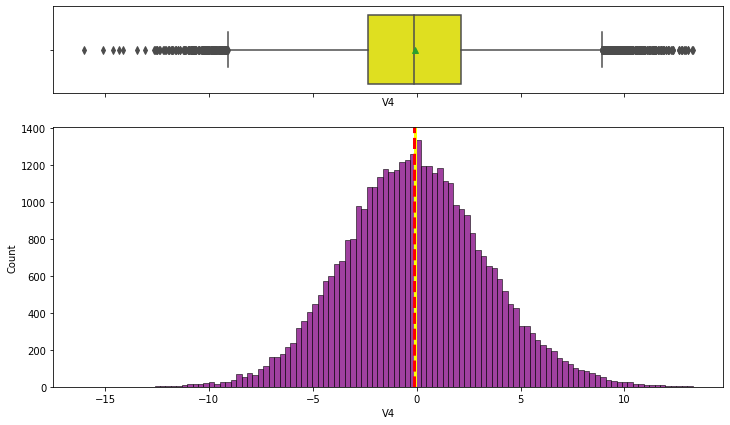

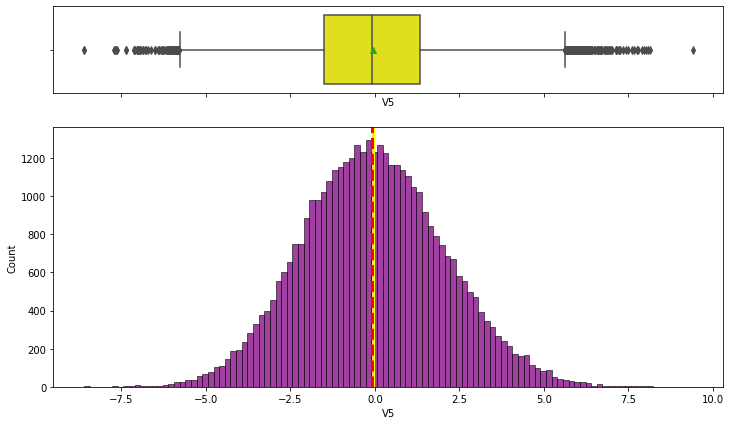

...

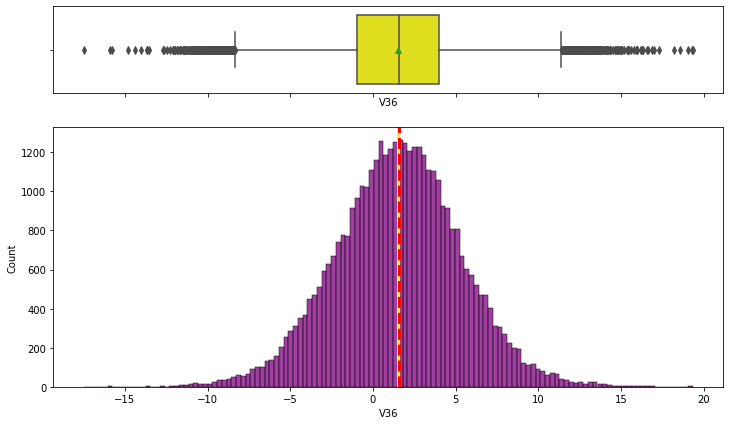

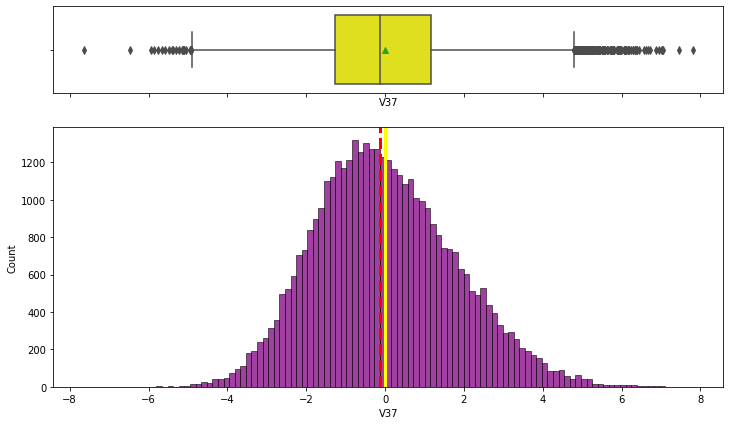

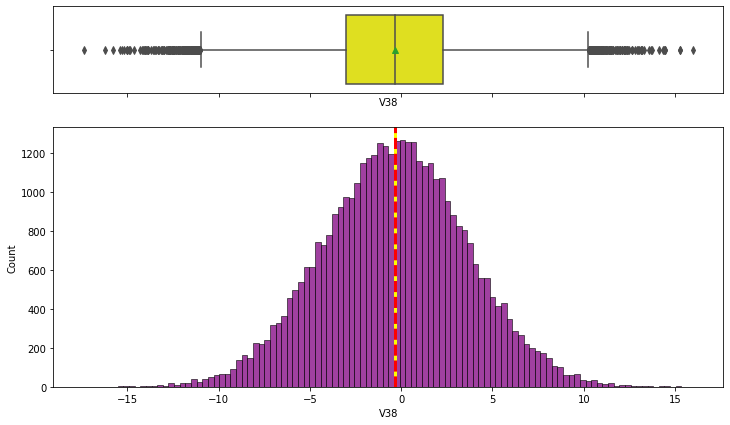

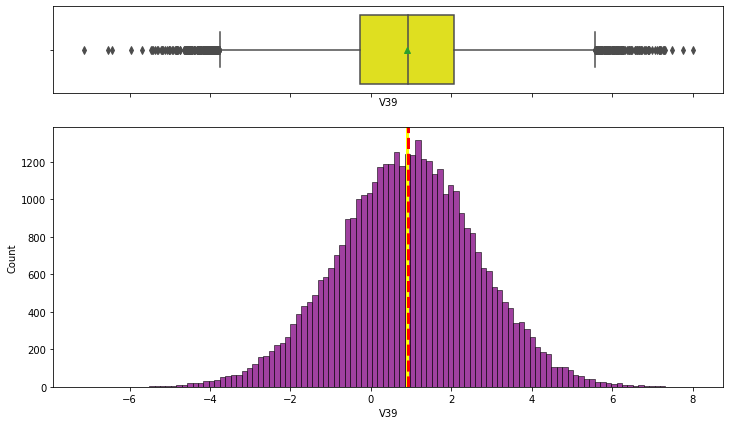

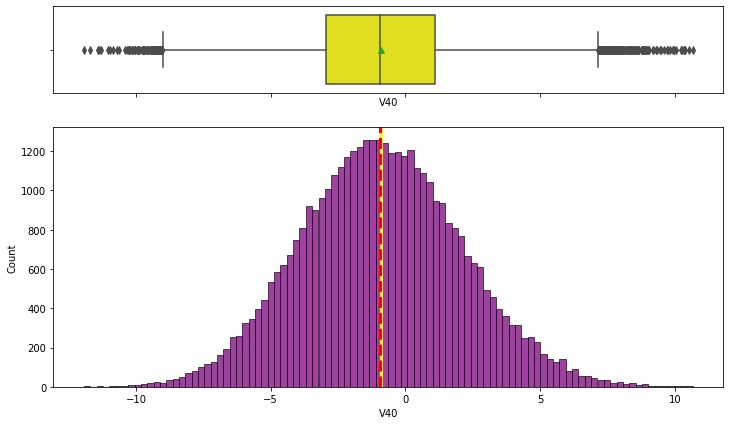

In [112]:
#plotting the the histogram and boxplot to analyze each feature
for feature in feature_list:
    histogram_boxplot(df, feature, figsize=(12, 7), kde=False, bins=None) ## plotting predictor variables
    

Let's analyze the graphic representation of each distribution along with the statistical summary of each predictor in order to get a better insight of the variables and outliers.
- V1: The variables V1 is right skewed, the mean value is -0.38 and the median value is -0.7. The outliers are present on both sides of the distribution, but it is especially noticeable on the higher values. We cannot know if the extreme upper values are a mistake or not because we do not know what V1 is referring to.
- V2: Mean and median values are very similar for V2, so we can talk about a normally distributed variable. When we check the variable plot, the distribution is very symmetrical and there are outliers equally spread on both extreme of the variable distribution.
- V3: This variable is slightly right skewed, but the shape is very similar to a bell-shaped distribution. There are outliers on both extremes but especially on the upper values of the distribution.
- V4: For variable 4, the mean value is slightly smaller than the mean value, both negative values (mean is -0.06 and median value is -0.124), the V4 variable is almost normally distributed. In this instance, there are more weight of outlier on the lower extreme even though they are present on both sides of the distribution.
- V5: The mean value of the distribution is slightly greater than the median value (-0.045 and -0.097 respectively), therefore the variable distribution is slightly right skewed but it is almost normally distributed. Again, we can see present of outliers in both extremes. The spread of outliers is also less uneven on the upper extreme.
- V6:This variable is also normally distributed with outliers on both extremes.
- V7: median value is -0.93 and mean value is -0.89, with both values so similar, V7 also present outliers in both extremes of the distribution. V7 is also Normally distributed.
- V8: Variable V8 distribution is slightly left skewed. median value is greater than mean value (-0.38 versus -0.56 respectively). The distribution has also outliers in both extremes.
- V9: Variable V9 is normally distributed and with a mean and median values very close (almost zero in both cases). The outliers are equally distributed in both extremes.
- V10: Variable V10 is left Skewed (mean value is near zero and median is 0.1. Even though there are outliers in both extremes, they concentrate heavily on the lower extreme of the distribution.
- V11: This variable is also normally distributed with a symmetrical shape, both, mean and median value are -1.9 and outliers appear equally distributed in both sides of the distribution.
- V12: This attribute also presents a bell-shape plot, with heavier outliers on the lower half of the distribution.
- V13: mean and median value are very similar (1.5 and 1.6 respectively) and with outliers on both extremes, especially the lower side of the distribution with a minimum value of -13.
- V14: Variable 14 shape is like a bell but with some irregularities. Mean a median value are 0.95 and outliers again present of both extremes. (Minimum value is -8 and maximum values is 6)
- V15: The variable 15 mean value and median variable are very similar (-2.4 and -2.39). The distribution shows a sharp pick in the middle and outlier values distributed similarly on both sides.
- V16: This distribution is left Skewed. Mean value is -2.9 and median value is -2.7. There are important present of outliers especially on the lower side of the distribution.
- V17: Variable 17 is slightly left skewed. Mean and median values are very close, (both zero), and with outliers in both sides, slightly more equally speeded on the lower extreme (maximum and minimum values are 17 and -17 respectively)
- V18: Variable V18 shows a sharp pick near the value zero, the distribution is also right skewed with irregular shape and outliers on both extremes.
- V19: Mean and median value of this distribution are very similar (1.18 and 1.2). With outliers on both extremes this distribution is almost normally distributed.
- V20: This distribution is very symmetrical, and we can see the mean and median value are almost 0.03. We can see lots of outliers, especially on the upper extreme. V12 is normally distributed.
- V21: Variable 21 is normally distributed with central values mean and median -3.6 and -3.5 respectively. There are outliers on both sides of the distribution.
- V22: Variable 22 is also normally distributed, counts with lots of outlier on both sides, but their weight is even heavier on the lower side of the distribution, with a minimum value of -19.
- V23: Mean value and median values are negatives (-0.38 and -0.27) for this distribution. There are outlies on both sides and the values are showing the plot of a bell-shaped distribution with minimum and maximum values distributed homogeneously on both sides.
- V24: This variable is almost normally distributed but there is a gap in the middle of the distribution and heavy outlies on both sides. Mean and median values are very similar, in the range of 1 and 1.1 respectively.
- V25: This distribution is similar to the normal distribution, but it is slightly negatively skewed. Outliers are present on both extremes.
- V26: Mean and median values are around 1.9. This distribution is normally distributed and counts with outlier on both sides, above all the upper extreme side with a maximum value of 16.8.
- V27: This distribution is slightly right skewed since the mean value is greater than the median (-0.6 and -0.9 respectively). The distribution shape is like a sharp bell and there are lots of outliers on both sides.
- V28: Variable 28 is normally distributed. We can see again outlier on both extremes but especially on the upper side. Mean and median values are -0.8 and -0.9. With minimum value is -9 and a maximum value of 6.9, the majority of outlier appear on the lower part of the distribution.
- V29: The distribution on V29 is right skewed and we can see the presents of outliers, especially on the lower part of the plot. Mean value is -1 and median values is -1.2 for V29.
- V30: Variable 30 is slightly left skewed and almost normally distributed with mean and median value around zero. There are outliers on both extremes.
- V31: Variable 31 is normally distributed, with mean and median values around 0.5. There are outliers on both extremes, but the lower outliers of the distribution are more dispersed.
- V32: Variable 32 is normally distributed. We can see again how the outliers on the lower side of the distribution are more dispersed and the bigger number of outliers concentrates on the upper side.
- V33: This variable is normally distributed. Outliers are symmetrical on both extremes, and we can see an important number of them in both sides. Both mean and median value is around 0.5.
- V34: The variable 34 is slightly left skewed and we can see a sharp bell shape as well. Outliers are present on both extremes, but more heavily on the lower side. Mean value is -0.46 and median value is -0.2 for variable 34. 
- V35: Variable 35 is very symmetrical with a small gap in the pick of the distribution. Even outliers are distributed symmetrically. Mean and median values are very similar (2.2 and 2.1 respectively).
- V36: variable 36 is normally distributed with a mean and median value of 1.5. There are outliers in both extremes of the distribution, especially on the upper side, but the outlier on the lower part are more dispersed.
- V37: Variable 37 follows a bell-shaped distribution that is slightly right skewed. With a mean value in zero and outliers on both side, variable 37 is not symmetric since most of the outliers are concentrated on the upper side.
- V38: Variable 38 is almost normally distributed. Mean and median values are -0.3 and the outlier are also symmetric on both sides, but with 
- V39: Variable 39 is also normally distributed. Median and mean value are similar, 0.9, and outliers are presents on both extremes of the distribution, but more spread on the lower extreme.
- V40: Variable 40 is normally distributed but we can find some asymmetry in the middle of the distribution. Mean and median value are around 0.9. Outlier can be found on both sides of the distribution but especially on the upper extreme.








#### B.Ploting Target train data

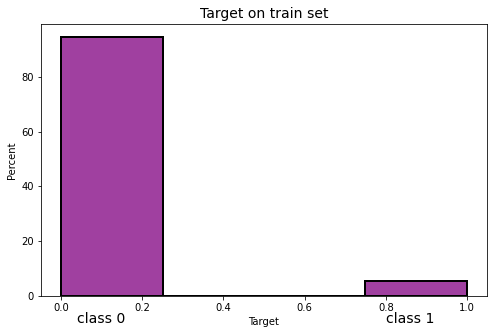

In [113]:
plt.figure(figsize=(8, 5))
sns.histplot(
    data=df,
    x=df["Target"],
    color='purple',
    stat="percent", binwidth= 0.25, linewidth=2
)#ploting histagram of the discrete variable Target to show the percentage 

plt.text(x=0.04,y=-10, s='class 0', fontsize=14)#add class 0
plt.text(x=0.8,y=-10, s='class 1', fontsize=14)#add class 1
plt.title('Target on train set', loc='center',fontsize=14)
plt.show()

- As we could initially see, the data is extremely imbalanced, we will have to fix this problem before we start building the models to give more weight to the weaker variable, that in this case is Class 1, the objective of our study.

### 3.2 UNIVARIATE ANALYSIS/ EDA ON TEST DATA

In [114]:
#Statistical summary
df_test.describe().T

,count,mean,std,min,25%,50%,75%,max
V1,9989.000,-0.260,3.440,-12.382,-2.700,-0.719,1.861,13.504
V2,9993.000,0.417,3.160,-11.625,-1.701,0.456,2.526,14.079
V3,10000.000,2.555,3.395,-12.941,0.238,2.283,4.656,15.409
V4,10000.000,-0.054,3.462,-14.682,-2.371,-0.169,2.144,12.896
V5,10000.000,-0.085,2.102,-7.712,-1.593,-0.144,1.324,7.673
V6,10000.000,-1.014,2.039,-8.949,-2.377,-1.015,0.354,6.273
V7,10000.000,-0.908,1.737,-8.124,-2.035,-0.938,0.189,7.616
V8,10000.000,-0.599,3.343,-12.710,-2.684,-0.387,1.698,10.792
V9,10000.000,0.026,2.180,-7.570,-1.490,-0.086,1.466,8.851
V10,10000.000,0.019,2.169,-8.291,-1.362,0.150,1.537,7.691


- The statistical distribution is of target and predictors is very similar in both data frames, test and train. The outliers follow similar patterns in both datasets and on the dataset, we can see how the range of outliers is a bit smaller. On the other hand, the distribution count with less data, so the outliers can affect the man values more significantly.

#### 3.2.2 Plotting histograms and boxplots on all variable for test data 

In [115]:
# function to plot a boxplot and a histogram along the same scale.


def histogram_boxplot(data, feature, figsize=(12, 7), kde=False, bins=None):
    """
    Boxplot and histogram combined

    data: dataframe
    feature: dataframe column
    figsize: size of figure (default (12,7))
    kde: whether to the show density curve (default False)
    bins: number of bins for histogram (default None)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(
        nrows=2,  # Number of rows of the subplot grid= 2
        sharex=True,  # x-axis will be shared among all subplots
        gridspec_kw={"height_ratios": (0.25, 0.75)},
        figsize=figsize,
    )  # creating the 2 subplots
    sns.boxplot(
        data=data, x=feature, ax=ax_box2, showmeans=True, color="Pink"
    )  # boxplot will be created and a star will indicate the mean value of the column
    sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2, bins=bins,color='Darkblue'
    ) if bins else sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2,color='Skyblue' 
    )  # For histogram
    ax_hist2.axvline(
        data[feature].mean(), color="yellow", linestyle="-", linewidth=3
    )  # Add mean to the histogram
    ax_hist2.axvline(
        data[feature].median(), color="red", linestyle="--", linewidth=3
    )  # Add median to the histogram

#### A.Plotting predictors on test data

In [116]:
#creating a list to feed the predictor features on the histogram boxplot function 
feature_list_test=['V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11',
       'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21',
       'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31',
       'V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'V38', 'V39', 'V40']

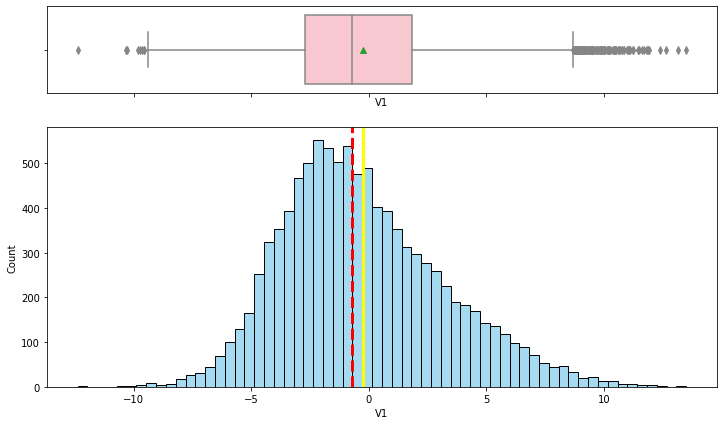

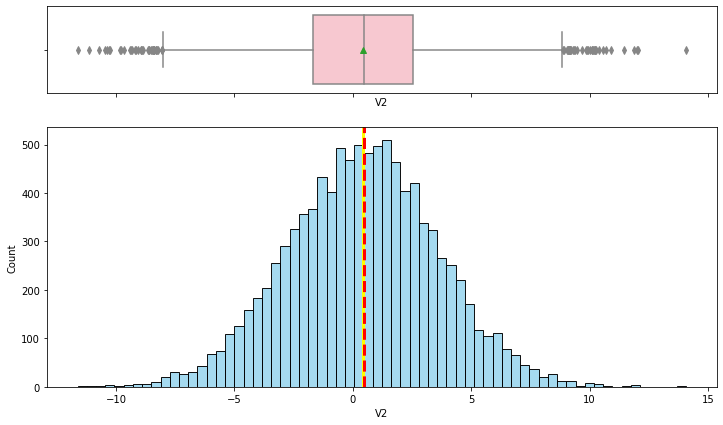

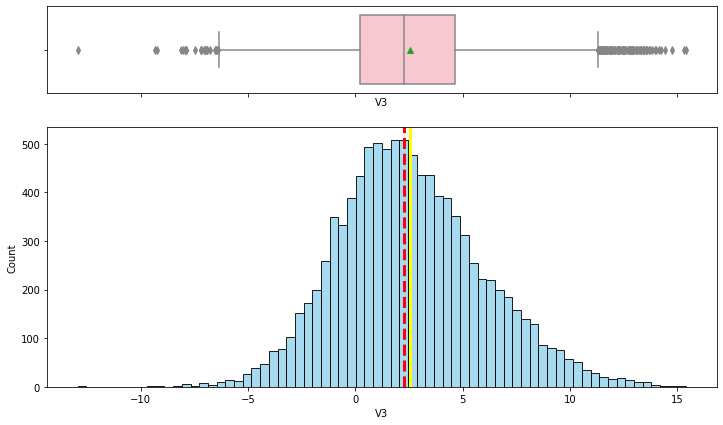

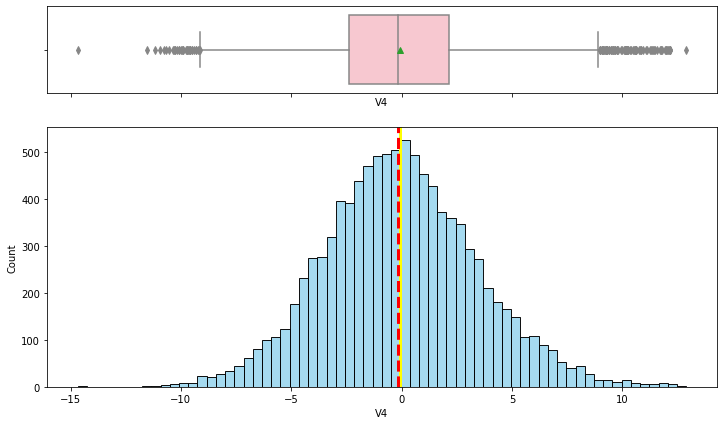

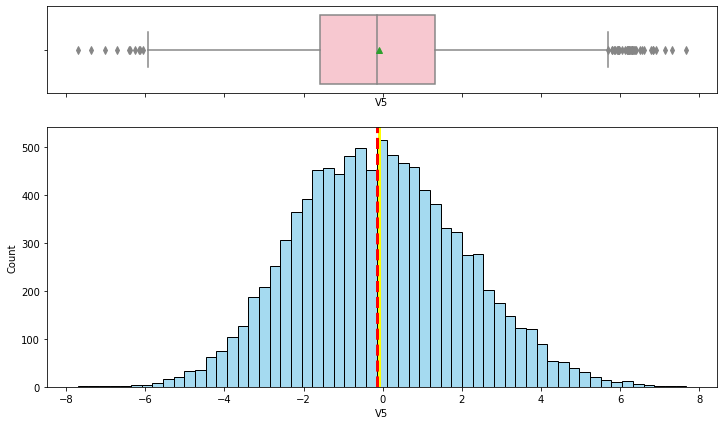

...

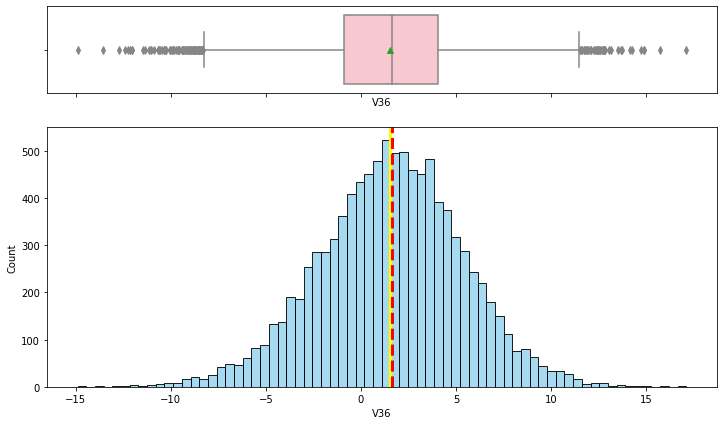

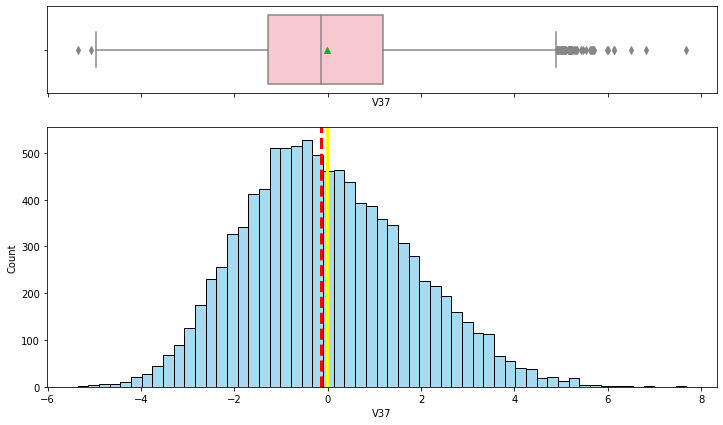

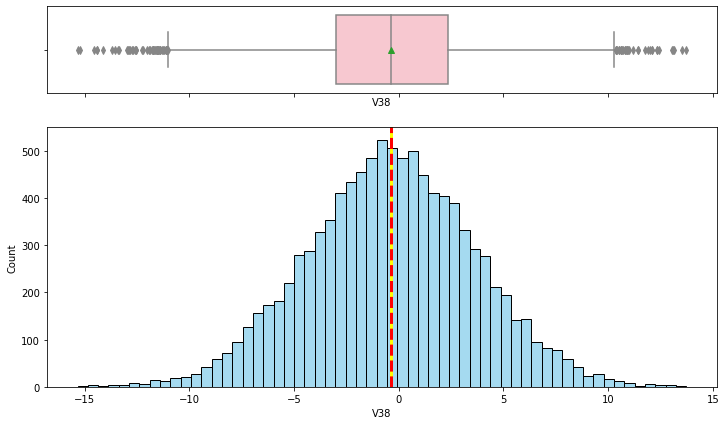

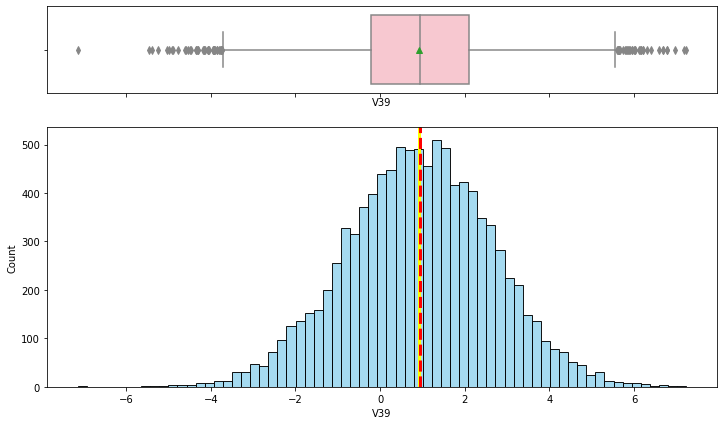

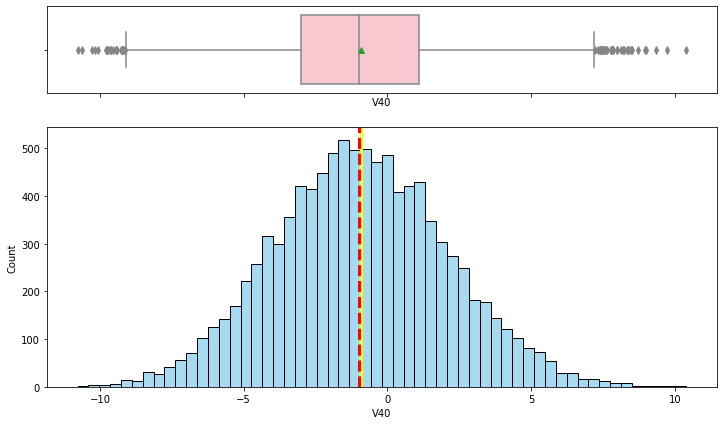

In [117]:
#plotting the the histogram and boxplot to analyze each feature of the test data
for feature in feature_list_test:
    histogram_boxplot(df_test, feature, figsize=(12, 7), kde=False, bins=None) ## plotting predictor variables
    

- In general, the behavior of each variable is very similar to the ones on the train set. Most of the distributions are normally or almost normally distributed, the bell shape is less smooth because we count with smaller amount of data on this set. Also, the outliers affect the mean value of the distributions. Still the behavior that we can see on test set it follows the same pattern than in the train set.
- The fact that both sets are presenting same behavior it is a sign that in fact, outliers should not be treated and be a part of the model since they may be part of the generic behavior of the distributions.


#### B.Plotting Target Variable on test set

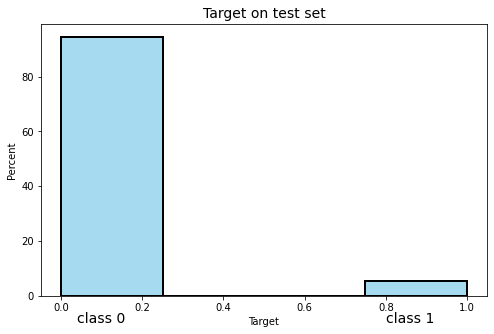

In [118]:
plt.figure(figsize=(8, 5))
sns.histplot(
    data=df,
    x=df_test["Target"],
    color='Skyblue',
    stat="percent", binwidth= 0.25, linewidth=2
)#ploting histagram of the discrete variable Target to show the percentage 

plt.text(x=0.04,y=-10, s='class 0', fontsize=14)#add class 0
plt.text(x=0.8,y=-10, s='class 1', fontsize=14)#add class 1
plt.title('Target on test set', loc='center',fontsize=14)#add title
plt.show()


In [119]:
df_test['Target'].value_counts(normalize=True)*100

0   94.530
1    5.470
Name: Target, dtype: float64

- The percentage for each class, 1 and 0, are equal to the train set so it will assure that the class weight modification will also apply to the test set in order to decide if the final model generalize well.

### 3.3 BIVARIATE ANALYSIS FOR TRAIN DATA

- Since we are creating our model on the train data, we are focusing our bivariate analysis on train data frame.
- We are analyzing the relationship among predictors and correlation.
- Also, we will analyze how the class of the target variable is influence by the most relevant predictors.



**a.PAIRPLOT**

In [33]:
df.columns

Index(['V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11',
       'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21',
       'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31',
       'V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'V38', 'V39', 'V40',
       'Target'],
      dtype='object')

In [34]:
plt.figure(figsize=(20,20))# set size
sns.pairplot(data=df.sample(50), diag_kind="kde", palette="rainbow", hue='Target')  # pairplot with histogram in the diagonal.


<Figure size 1440x1440 with 0 Axes>

- The pair plot representation with all the variables is not possible to visualize, therefore we are going to divide the variables in four groups.

In [35]:
#Since the pairplot cannot show all the information due to the high number of columns, let's divide the data in two halves.
df_pair1=df[['V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10','Target']]
df_pair2=df[['V11','V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'Target']]
df_pair3=df[['V21','V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30','Target']]
df_pair4=df[['V31','V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'V38', 'V39', 'V40','Target']]



<Figure size 1440x1440 with 0 Axes>

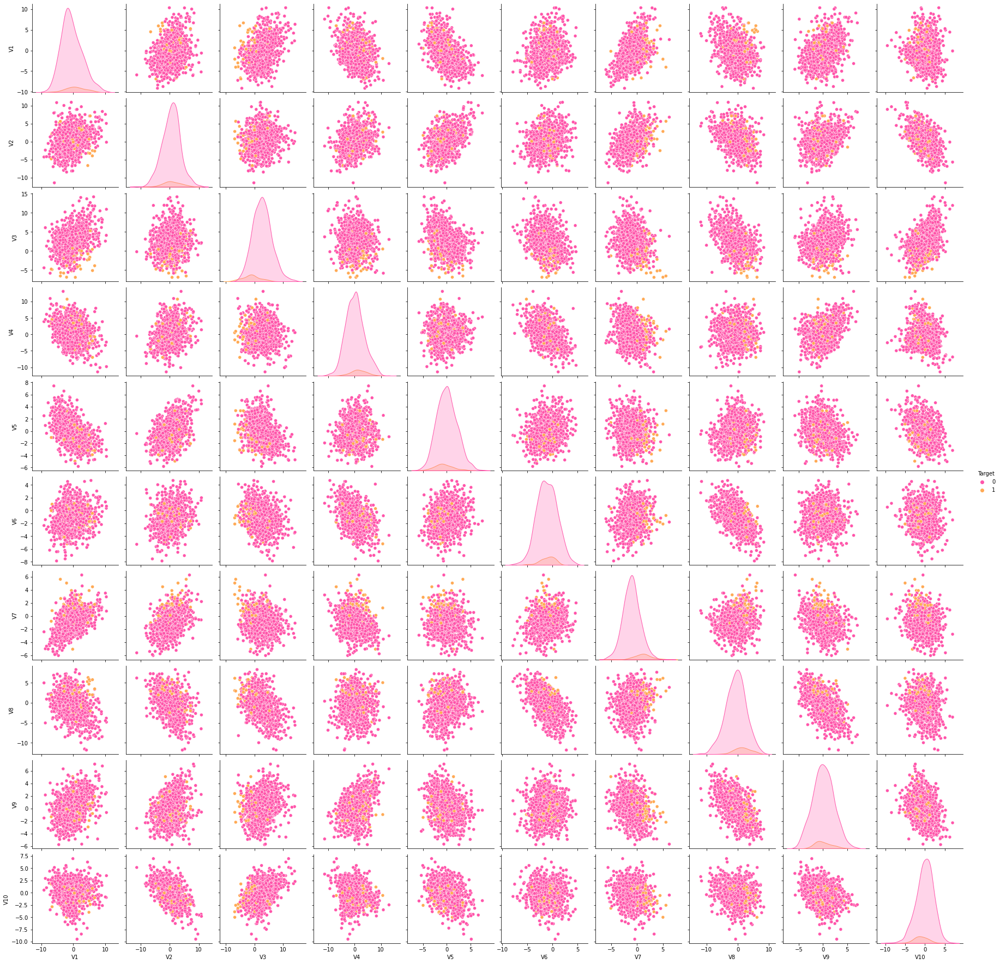

In [65]:
plt.figure(figsize=(20,20))# set size
sns.pairplot(data=df_pair1.sample(1000), diag_kind="kde", palette="spring", hue='Target')  # pairplot with histogram in the diagonal.

•	By using pair plot function with some of the variables we have limited the number of variables that we can compare so it will not show a pairwise comparison for all of them, but it will help visualize how small is the proportion of class 1 in the data. only a few orange points on each representation.

•	As we will check later on with the use of the heatmap, it seems that there is certain relationship between some variables, for example, Variable V1 and V7 show a positive pattern, on the other hand Variables 8 and 9 show the opposite behavior.


<Figure size 1440x1440 with 0 Axes>

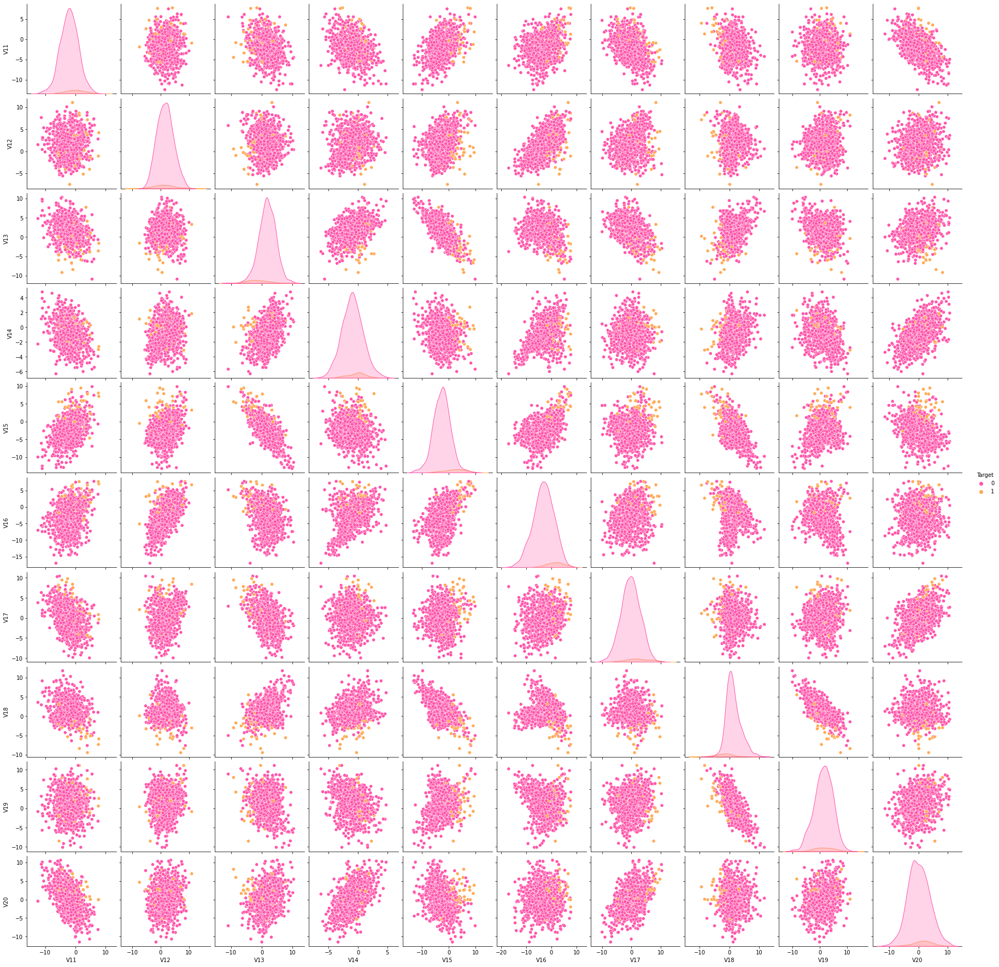

In [67]:
plt.figure(figsize=(20,20))# set size
sns.pairplot(data=df_pair2.sample(1000), diag_kind="kde", palette="spring", hue='Target')  # pairplot with histogram in the diagonal.

- On this second subset of pair plot, we are representing variables from V11 to V20. 
- The same proportion of class 1 and class 0 (represented on orange and pink respectively, as the legend above shows).
- We can see some variables with no specific scatterplot pattern but for others like variable V14 and V15, the scatterplot shows a negative pattern that we will need to confirm later on with the help of a heatmap.
- Since the number of columns and the data are quite big, we only have used a sample of 1000 values of the total data in order to simplify the process.


<Figure size 1440x1440 with 0 Axes>

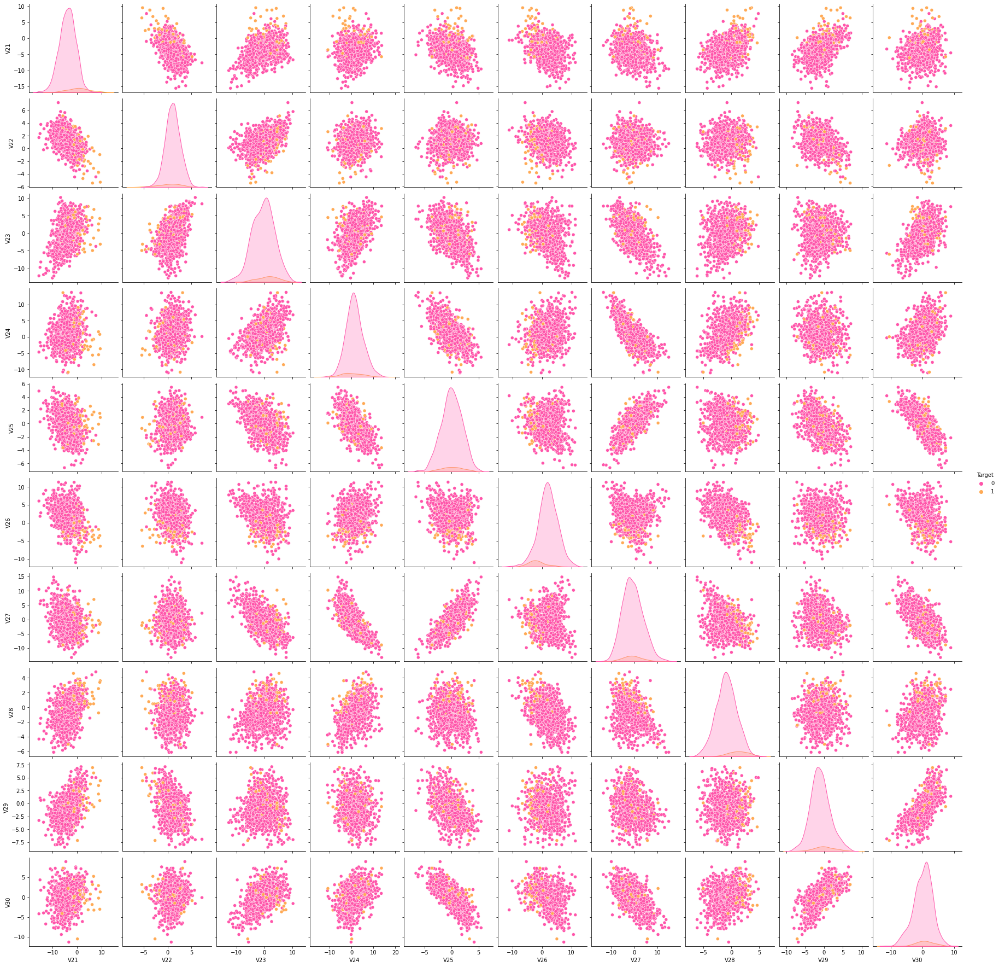

In [68]:
plt.figure(figsize=(20,20))# set size
sns.pairplot(data=df_pair3.sample(1000), diag_kind="kde", palette="spring", hue='Target')  # pairplot with histogram in the diagonal.

- As we initially explained, we have created a pairwise representation of for each 10 variables along with the target to see the behavior of the distribution in regards with the different class.
- In this subplot we have analyzed data for variables V21 to V30 based on a sample of 1000 values. In this plot we again see some patterns for some pair of variables that could be a sign of positive of negative correlation, but we cannot conclude this information until later when comparing with a heatmap.
- Variable V21 and V30 scatter plot shows dispersed data, that do not follow patterns so we could not see any relationship among the mentioned predictors. 
- Variables V25 and V3 on the other hand show certain negative pattern that we will have to check later. The relationship for V30 and V29 could be positive since the scatterplot also shows a positive trend that we will need to study further.


<Figure size 1440x1440 with 0 Axes>

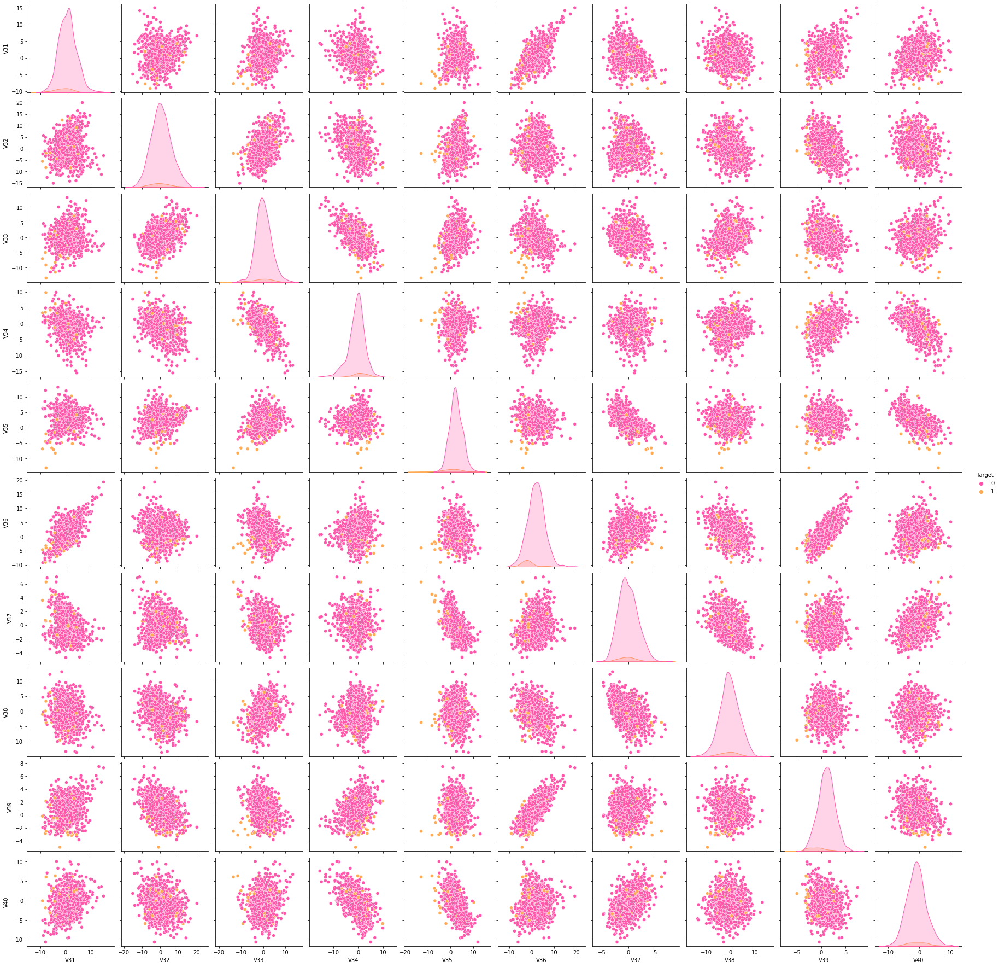

In [69]:
plt.figure(figsize=(20,20))# set size
sns.pairplot(data=df_pair4.sample(1000), diag_kind="kde", palette="spring", hue='Target')  # pairplot with histogram in the diagonal.

- In these four subsets of pairwise graphic representations, we have also selected a random sample of 1000 values to enhance plot efficiency. This subset contains variables from V31 to 40 plus the target that is used to separate the classes of study.
- In each plot the orange dots (related to class 1 are in a very small proportion).
- In general, for most of the predictors both classes overlap so it is not a clear indicator of which predictors are better for the model.
- For some variables as V39 and V36 the plot shows a positive relationship; in other cases the scatterplots are not following any patterns what means not relationship among those variables.
- The heatmap will be a great help to confirm our initial observations.


**b. HEATMAP AND CORRELATION**

<AxesSubplot:>

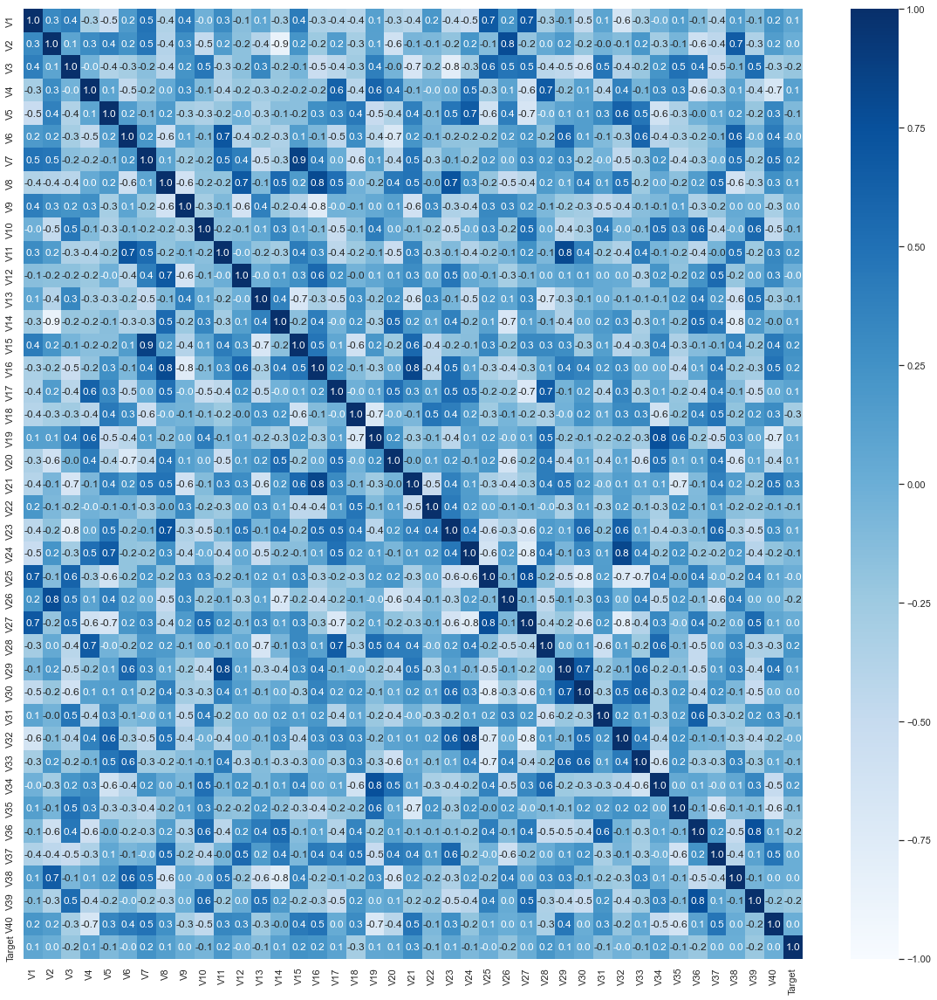

In [49]:
"""we will plot a heatmap with a min value of -1 and max value of 1 to simulate the 
coefficient of correlation."""
plt.figure(figsize=(20, 20))  # setting the size of the plot
sns.heatmap(df.corr(), vmin=-1, vmax=1, annot=True, fmt=".1f", cmap='Blues',annot_kws={"size": 12})  # creating heatmap with annotations
plt.yticks(rotation=90)

- There is high positive and negative correlation amongst some of the predictors, any variable with a correlation will affect the interpretation of a logistic model. 
- We will rely on regularization methods as lasso to eliminate the effect of multicollinearity to create a logistic regression model. 
- We can see some positive correlation among variables with a dark blue color on the heatmap graphic representation. Some examples are: V7 and V15 (the correlation coefficient is very high, 0.9 being 1 the maximum value), V36 and V39, V32 and V24, V29 and V11, V8 and V26 with a coefficient of 0.8, what is also high. One of these pairs of variables increase, the other variable also increases, the higher the coefficient the higher the correlation. They move in the same direction.
- Variables with a white color assigned are negative highly correlated. In this case, when the variables are negatively correlated, the closest the number is to -1 the stronger is the correlation. This is the case of variables very high correlated as V2 and V14 with a coefficient of correlation of -0.9, and other with a moderate-high correlation as V3 and V23, V38 and V14 with coefficients of correlation around -0.8. The relationship between these variables is inverse, so when one variable increases the other will decrease.


**c.BOXPLOTS FOR EACH VARIABLE VERSUS TARGET / OUTLIER**

- We are checking outliers in both classes (o and 1) to see how each of them is affected. In order to do so, we are dividing the features in four separated lists in order to speed up the process.


In [120]:
# Separating the different features in four dataframe to speed up the process.
list_out_1=['V1', 'V2', 'V3', 'V4', 'V5','V6', 'V7', 'V8', 'V9', 'V10']
list_out_2=['V11','V12', 'V13', 'V14', 'V15','V16', 'V17', 'V18', 'V19', 'V20']
list_out_3=['V21','V22', 'V23', 'V24', 'V25','V26', 'V27', 'V28', 'V29', 'V30']
list_out_4=['V31','V32', 'V33', 'V34', 'V35','V36', 'V37', 'V38', 'V39', 'V40']


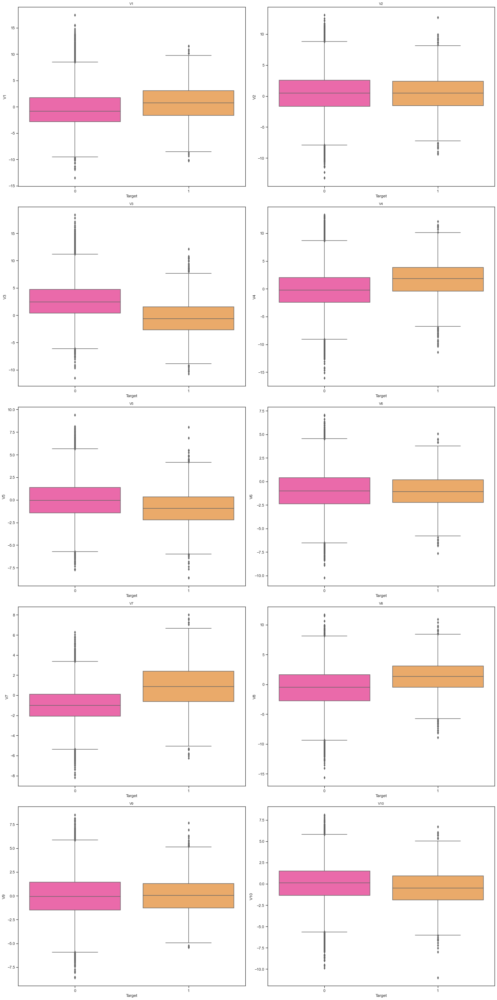

In [48]:
#plotting first subset of ouliers
plt.figure(figsize=(20, 40))

for i in range(len(list_out_1)):
    plt.subplot(5, 2, i + 1)
    sns.boxplot(
        y=df[list_out_1[i]],
        x=df['Target'],
        palette="spring")
    plt.title(list_out_1[i], fontsize=10)
    plt.tight_layout()
    plt.show

- For this first subset of variables, V1 to V10 we can appreciate that in general there are more outliers on the class 1 than class 0, and since we have more data for this class it makes sense that the number of outliers is greater.
- Also, we can see for few of the features, the median value for the class 0 and 1 is very different. This variable could be better predictors since we could classify by median values the generators with higher risk of failure. Those variables with a significant difference in the median value are: v3 and V7. They seem to be the ones initially to consider as good predictors for classification.


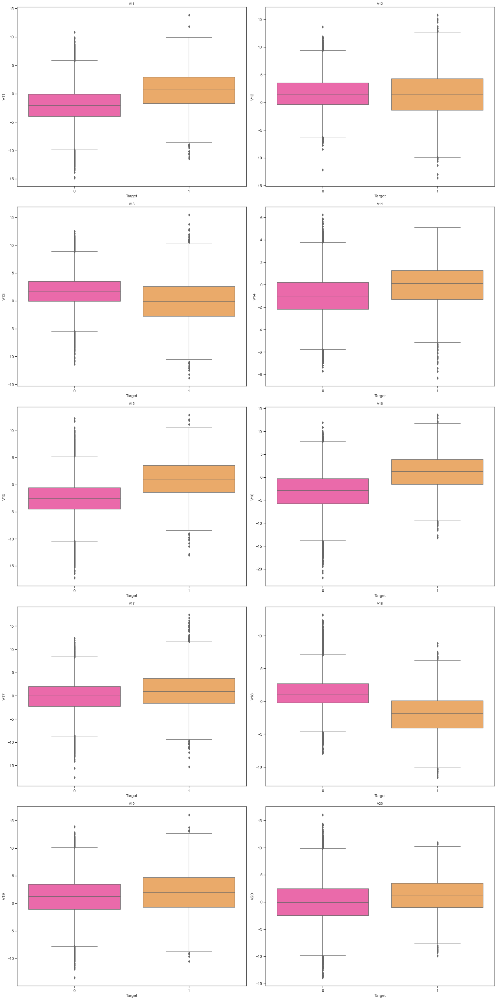

In [43]:
#plotting second subset of ouliers

plt.figure(figsize=(20, 40))

for i in range(len(list_out_2)):
    plt.subplot(5, 2, i + 1)
    sns.boxplot(
        y=df[list_out_2[i]],
        x=df['Target'],
        palette="spring")
    plt.title(list_out_2[i], fontsize=10)
    plt.tight_layout()
    plt.show

- For this second subset, we have variables with lots of outlier for both classes, and in general class 0 has more outlies, since we have more data for this class as well.
- We can see that for some variable the data is more spread on class 1, for example variable V12 and V18.
- Variables V15 and V16 show a much greater median value for the class 1, and the opposite is true for V18 with a much lower mean value for class 1. Again, these three variables can be helpful in building a classification model.


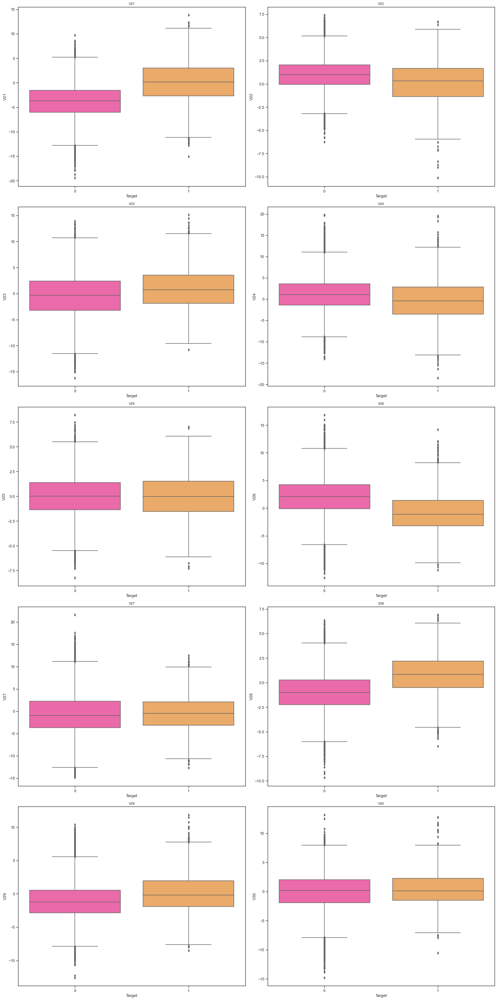

In [44]:
#plotting third subset of ouliers

plt.figure(figsize=(20, 40))

for i in range(len(list_out_3)):
    plt.subplot(5, 2, i + 1)
    sns.boxplot(
        y=df[list_out_3[i]],
        x=df['Target'],
        palette="spring")
    plt.title(list_out_3[i], fontsize=10)
    plt.tight_layout()
    plt.show

- We can see for each feature, there are more outliers on class 1 for this subset that includes variables V21 to V30. 
- For variable V21 and V22 the data is more spread on class 0.
- Mean value is considerable different for variables V21 and V26 when comparing both classes. It could be a way to identify the damaged generators.


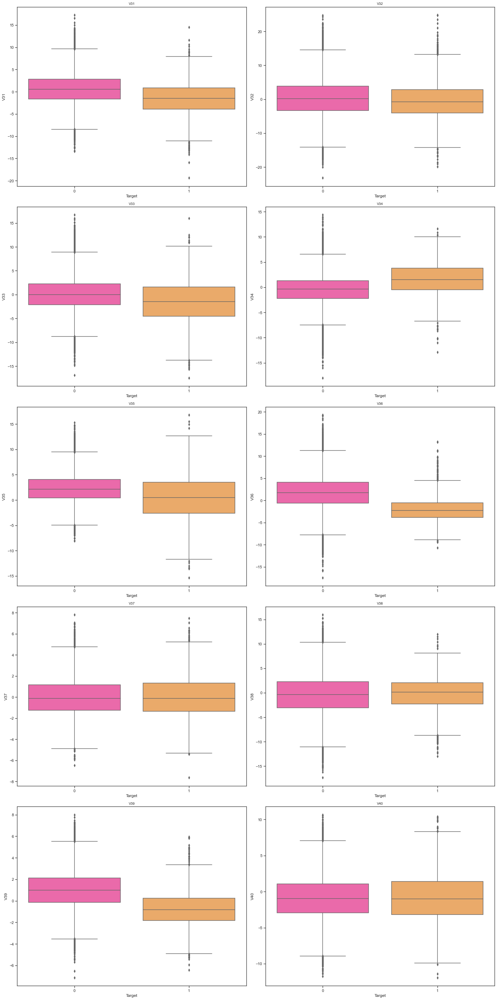

In [45]:
#plotting third subset of ouliers

plt.figure(figsize=(20, 40))

for i in range(len(list_out_4)):
    plt.subplot(5, 2, i + 1)
    sns.boxplot(
        y=df[list_out_4[i]],
        x=df['Target'],
        palette="spring")
    plt.title(list_out_4[i], fontsize=10)
    plt.tight_layout()
    plt.show


- For the fourth subset of variables we have outliers again for both classes. The data is more spread for class 1 for variables as v33.
- There is again a relevant difference in the median values for variables V39 and V36, with a much lower median values for class 1. This can be helpful for preventing generator failure.


## 4.Checking for outliers and outlier treatment.



In [251]:
# creating list to check outliers
list_out=['V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11',
       'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21',
       'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31',
       'V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'V38', 'V39', 'V40']

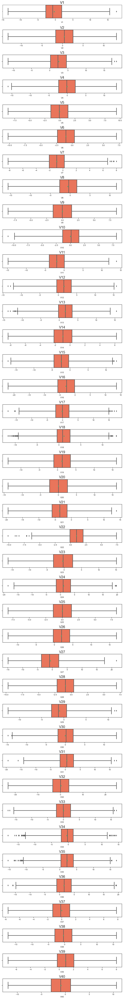

In [252]:
#plotting outliers 

plt.figure(figsize=(10,80))

for i in range(len(list_out)):
    plt.subplot(40, 1, i + 1)
    sns.boxplot(
    x=df[list_out[i]],showmeans=True, palette ="Reds",linewidth=3,
        saturation=0.8,
        width=1,whis=3)
    plt.title(list_out[i], fontsize=20)
    sns.set_theme(style="ticks")
    plt.tight_layout()
   
   

In [253]:
#We make a copy of df for outlier treatment before we continue 
df_out=df.copy()

Generally speaking we could treat outliers by capping and flooring all of them.

Lower outlier is Q1-3 *IQR,calculation for the minimum values accepted

Upper outlier is Q3+3 *IQR, calculation for the maximun values accepted
The above information shows the formulas used for treating outliers in a very conservative way. We do not want to modify many of the outlier values.




Q1=df_out[col].quantile(0.25)# 25th quantile

Q3=df_out[col].quantile(0.75)# 75th quantile

IQR=Q3-Q1# interquartile range

lw=Q1-3*IQR#lower whisker

uw=Q3+3*IQR# upper whisker



In [254]:
for col in list_out:

    Q1=df_out[col].quantile(0.25)

    Q3=df_out[col].quantile(0.75)

    IQR=Q3-Q1

    lw=Q1-3*IQR

    uw=Q3+3*IQR

    print(col,lw,uw)

    df_out[col]=np.clip(df_out[col],lw, uw)

    print('max',df_out[col].min(), 'min',df_out[col].max())

    print('_______')


V1 -16.515962569750002 15.601210178750001
max -13.50188006 min 15.601210178750001
_______
V2 -14.165942665 15.065095331999999
max -13.21205074 min 13.08926877
_______
V3 -12.944031179250002 17.731633742750002
max -11.4693687 min 17.731633742750002
_______
V4 -15.844084222000001 15.643105772750001
max -15.844084222000001 min 13.27971155
_______
V5 -10.0674959205 9.906514065500001
max -8.612973102 min 9.403468678
_______
V6 -10.575511134500001 8.585974639
max -10.22714678 min 7.065470283
_______
V7 -8.76811309125 6.9380198145
max -8.205806353 min 6.9380198145
_______
V8 -15.7848093355 14.8387769585
max -15.65756062 min 11.67949526
_______
V9 -10.251845123499999 10.183882120249999
max -8.596313119 min 8.50713812
_______
V10 -10.020511522 10.11606686475
max -10.020511522 min 8.108472118
_______
V11 -16.03221087675 12.18068596125
max -14.83205777 min 12.18068596125
_______
V12 -12.347853103 15.457267143750002
max -12.347853103 min 15.457267143750002
_______
V13 -11.263095407749999 14.530909

### 4.1 MODEL BUILDING WITH OUTLIER TREATMENT

Let's check how the df_out, without outliers behaves when creating a model.

In [255]:
# divide data into predictors and target
x_out=df_out.drop('Target',axis=1)
y_out=df_out['Target']

In [256]:
#make copy of df_test to treat outlier and use for modeling
df_test_out=df_test.copy()

In [257]:
#create  
x_test_out=df_test_out.drop('Target', axis=1)
y_test_out=df_test_out['Target']

In [258]:
# splitting data in validation and training test with a ration 70:30.
x_train_out,x_val_out,y_train_out,y_val_out= train_test_split(x_out,y_out,test_size=0.3,random_state=1, stratify=y_out)

In [259]:
x_val_out.isna().sum().sort_values(ascending=False).head(3)

V2     20
V1      6
V23     0
dtype: int64

In [260]:
x_train_out.isna().sum().sort_values(ascending=False).head(3)

V1     40
V2     19
V23     0
dtype: int64

In [261]:
x_test_out.isnull().sum().sort_values(ascending=False).head(3)

V1     11
V2      7
V23     0
dtype: int64

In [262]:
#imputing null values will provide a numpy array as result
imputer_out=SimpleImputer(missing_values=np.NaN,strategy='median')
#fitting and transforming x_train_out
x_train_imp=imputer_out.fit_transform(x_train_out)

#transforning x_val_out and x_test_out
x_val_imp=imputer_out.transform(x_val_out) 
x_test_imp=imputer_out.transform(x_test_out)


In [263]:
#converting arrays back in dataframes
x_train_out=pd.DataFrame(x_train_imp, columns=x_train_out.columns)
x_val_out=pd.DataFrame(x_val_imp, columns=x_val_out.columns)
x_test_out=pd.DataFrame(x_test_imp, columns=x_test_out.columns)


In [264]:
#Checking for null values
x_val_out.isna().sum().sort_values(ascending=False).head(3)

V1     0
V2     0
V23    0
dtype: int64

In [265]:
#Checking for null values
x_train_out.isna().sum().sort_values(ascending=False).head(3)

V1     0
V2     0
V23    0
dtype: int64

In [266]:
#Checking for null values
x_test_out.isnull().sum().sort_values(ascending=False).head(3)

V1     0
V2     0
V23    0
dtype: int64

**Checking outlier treatment on different models**

In [267]:
models = []  # Empty list to store all the models

# Appending models into the list
models.append(("dtree", DecisionTreeClassifier(random_state=1)))
models.append(("Logistic regression", LogisticRegression(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("GradientBoosting", GradientBoostingClassifier(random_state=1)))
models.append(("AdaBoost", AdaBoostClassifier(random_state=1)))
models.append(("RandomForert", RandomForestClassifier(random_state=1)))
models.append(("XGBoost", XGBClassifier(random_state=1,eval_metric='logloss')))



results_out = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation Cost:" "\n")

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=x_train_out, y=y_train_out, scoring=scorer, cv=kfold
    )
    results_out.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean()))

print("\n" " Validation Performance :" "\n")

for name, model in models:
    model.fit(x_train_out, y_train_out)
    scores_validation_out = recall_score(y_val_out, model.predict(x_val_out))
    print("{}: {}".format(name, scores_validation_out))
    print('******************************************')


Cross-Validation Cost:

dtree: 0.7413212407655788
Logistic regression: 0.48858444572182835
Bagging: 0.7250069191628878
GradientBoosting: 0.7230291030635925
AdaBoost: 0.6192012092567755
RandomForert: 0.757665367993017
XGBoost: 0.8242958421153478

 Validation Performance :

dtree: 0.7454268292682927
******************************************
Logistic regression: 0.4679878048780488
******************************************
Bagging: 0.7240853658536586
******************************************
GradientBoosting: 0.7195121951219512
******************************************
AdaBoost: 0.6051829268292683
******************************************
RandomForert: 0.7637195121951219
******************************************
XGBoost: 0.8246951219512195
******************************************


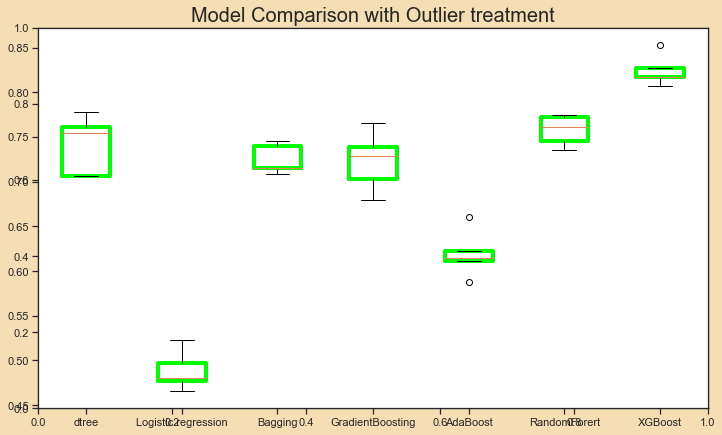

In [304]:

fig2=plt.figure(figsize=(12,7), facecolor='wheat')#setting plot size
plt.title('Model Comparison with Outlier treatment', fontsize=20
         )#adding title
ax2=fig2.add_subplot(111)# add plots on the same graph
bp=plt.boxplot(results_out)# plot cross validation results per model
ax2.set_xticklabels(names)#add name labels to each model
for box in bp['boxes']:
    box.set(color='lime', linewidth=4)
plt.show()


- As we will see later, the result for each of the model is very similar to the one with not outlier treatment. There is not any advantage of performing outlier treatment in this case and we risk losing information since we do not really have enough information to determine if an extreme value should be consider modified.
- According to the cross validation recall score, XGBoost is the one with better performance.

### Outlier treatment decision

We are not treating outliers at this time for two main reasons: 
- We do not have enough information to know if the extreme values of the distribution of each of the features are really outliers or a different group of values with a specific behavior that should also be considered. It not possible to consider outlier treatment if the information we are given is ciphered, so we do not really have a good sense of our data.
- Also, the test data analyzed on EDA previously, shows the same patterns for each of the variables. So, these may be just natural outliers of the distributions that help us find different behaviors of data inside the distributions. Indeed, the extreme values can be also useful for data prediction.
- We are working mostly with tree decision model that are very robust against outliers.


## 5.Data Pre-processing

In [330]:
# We are creating a copy of both datasets, train and test in order to not affect the original data.
df_train2=df.copy()
df_Test2=df_test.copy()

**TRAIN DATA FRAME PRE-PROCESSING**

We are building out model on train set. Test set will be set aside and  used at the end to test our final model.

In [331]:
#Dividing data into predictors and target variables for df (train data set)
x=df.drop('Target',axis=1)
y=df['Target']

- Since we do not have categories, we do not need to create any dummy variables. We can directly divide the data in train and validation sets.

In [332]:
#spliting train data frame in train set and validation set on a ration 70 % for training the model and 30% for validation
#In order to keep the same proportion of classes in both y_val and y_train, we use stratify argument.
x_train,x_val,y_train,y_val= train_test_split(x,y,test_size=0.3,random_state=1, stratify=y)

In [333]:
x_train.shape

(28000, 40)

In [334]:
print(f'x_train contains {x_train.shape[0]} rows and {x_train.shape[1]} columns')

x_train contains 28000 rows and 40 columns


In [335]:
x_val.shape

(12000, 40)

In [336]:
print(f'x_val contains {x_val.shape[0]} rows and {x_val.shape[1]} columns')

x_val contains 12000 rows and 40 columns


In [337]:
print(y_train.shape)
y_train.value_counts(normalize=True)

(28000,)


0   0.945
1   0.055
Name: Target, dtype: float64

In [338]:
print(y_val.shape)
y_val.value_counts(normalize=True)

(12000,)


0   0.945
1   0.055
Name: Target, dtype: float64

- Both validation and train data set keep the same class proportion that we had in the original dataset.
- Y_val contains 12000 rows
- Y_train contains 28000 rows.

**TEST DATA FRAME PRE-PROCESSING**

In [339]:
# spliting test set in x_test and y_test

x_test=df_test.drop('Target', axis=1)
y_test=df_test['Target']

In [340]:
x_test.shape

(10000, 40)

In [341]:
print(f'x_test contains {x_test.shape[0]} rows and {x_test.shape[1]} columns')

x_test contains 10000 rows and 40 columns


In [342]:
print(y_test.shape)
y_test.value_counts(normalize=True)

(10000,)


0   0.945
1   0.055
Name: Target, dtype: float64

- y_test contains 10000 rows and the class 0 and 1 mantain the same proportion than the other y variables (y_val and y_train).

## 5.1 Treating missing values on data frame without outlier treatment

In [343]:
#making copies of x variables before imputing data 
x_train2=x_train.copy()
x_val2=x_val.copy()
x_test2=x_test.copy()

- We are using two different imputers for missing values and will try them both in the models to pick the one that provides better results.

### A.Method1: IMPUTING DATA WITH SIMPLE IMPUTER

Sklearn simple imputer use the median value of each feature to impute the null values of each column. This eliminate the influence of the outliers since the median value is not affected.

In [344]:
#creating and imputer to impute null values in all missing values for test, validation and train set
# we are imputing the median value of each column to avoid the influence of outliers
imputer=SimpleImputer(missing_values=np.NaN,strategy='median')


In [345]:
#fitting and transforming x_train. 
x_train_imp1=imputer.fit_transform(x_train)
#transforning x_val and x_test
x_val_imp1=imputer.transform(x_val)
x_test_imp1=imputer.transform(x_test)



In [346]:
#Since the data imputation generates a numpy array we are transforming data back to dataframes.

x_train=pd.DataFrame(x_train_imp1, columns=x_train.columns)
x_val=pd.DataFrame(x_val_imp1, columns=x_val.columns)
x_test=pd.DataFrame(x_test_imp1, columns=x_test.columns)

In [347]:
#chekcing for null values on train set. 
x_train.isna().sum().sort_values(ascending=False).head(3)


V1     0
V2     0
V23    0
dtype: int64

- Data set x_train does not have any null values anymore.

In [348]:
#chekcing for null values on validation set. 
x_val.isna().sum().sort_values(ascending=False).head(3)


V1     0
V2     0
V23    0
dtype: int64

- Data set validation does not have any missing values after imputation.

In [349]:
#chekcing for null values on validation set. 
x_test.isna().sum().sort_values(ascending=False).head(3)

V1     0
V2     0
V23    0
dtype: int64

- Data set test does not have any missing values after tranformation.

### B. Method2: IMPUTING DATA WITH KNN IMPUTER

We are imputing data with KNN imputer for sklearn to fill the null values. we will use the 10 nearest neighbors from the train set and will calculate the average. Since we are building a classification model, we need to round up to the nearest integer.

In [350]:
#imputer will use the average value of the 10 nearest neighborg data points.
imputer=KNNImputer(missing_values=np.nan,n_neighbors=10)

In [351]:
#fitting and transforming x_train2. 
x_train_imp2=imputer.fit_transform(x_train2)
#transforning x_val2 and x_test2
x_val_imp2=imputer.transform(x_val2)
x_test_imp2=imputer.transform(x_test2)


In [352]:
#Since the data imputation generates a numpy array we are transforming data back to dataframes.

x_train2=pd.DataFrame(x_train_imp2, columns=x_train2.columns)
x_val2=pd.DataFrame(x_val_imp2, columns=x_val2.columns)
x_test2=pd.DataFrame(x_test_imp2, columns=x_test2.columns)

In [353]:
#chekcing for null values on train set. 
x_train2.isna().sum().sort_values(ascending=False).head(3)

V1     0
V2     0
V23    0
dtype: int64

- There is not any missing data on x_train2 after imputation

In [354]:
#chekcing for null values on validation set. 
x_val.isna().sum().sort_values(ascending=False).head(3)


V1     0
V2     0
V23    0
dtype: int64

- There is not any missing data on x_val2 after imputation

In [355]:
#chekcing for null values on validation set. 
x_test.isna().sum().sort_values(ascending=False).head(3)

V1     0
V2     0
V23    0
dtype: int64

- There is not any missing data on x_test2 after imputation

## 6. Model Building

### Model evaluation criterion

The nature of predictions made by the classification model will translate as follows:

- True positives (TP) are failures correctly predicted by the model.
- False negatives (FN) are real failures in a generator where there is no detection by model. 
- False positives (FP) are failure detections in a generator where there is no failure.
- True negatives(TN) are generators that are not in need of reparation that are correctly predicted by the model.


### Which are the loss in predicting incorrectly?

**Replacement cost = $40,000**

**Repair cost = $15,000**

**Inspection cost = $5,000**

- If do not predict that a turbine will break on time,  we will have to pay a higher price rate, since it may need to be replaced and as per the reparation list shown above, replacement cost is the most expensive.
If we predict the failure on time, we will save a big amount of money on the turbine reparation.

- On the other hand if we misclassify the risk of the turbines to fail, and request a turbine to be inspected when it is not at risk of breaking, we will be increasing the plant operational/ maintenance cost, affecting the wind plant profit.

### Which of the two losses is more damaging for a wind plant?
- The first one, false negatives (turbine that break and we do not predict on time) because the cost reparation is higher.


### Which metric to optimize?

* We need to choose the metric which will ensure that the maximum number of generator failures are predicted correctly by the model.
* We would want Recall to be maximized as greater the Recall, the higher the chances of minimizing false negatives.
* We want to minimize false negatives because if a model predicts that a machine will have no failure when there will be a failure, it will increase the maintenance cost.

**Let's define a function to output different metrics (including recall) on the train and test set and a function to show confusion matrix so that we do not have to use the same code repetitively while evaluating models.**

In [356]:
# defining a function to compute different metrics to check performance of a classification model built using sklearn
def model_performance_classification_sklearn(model, predictors, target):
    """
    Function to compute different metrics to check classification model performance

    model: classifier
    predictors: independent variables
    target: dependent variable
    """

    # predicting using the independent variables
    pred = model.predict(predictors)

    acc = accuracy_score(target, pred)  # to compute Accuracy
    recall = recall_score(target, pred)  # to compute Recall
    precision = precision_score(target, pred)  # to compute Precision
    f1 = f1_score(target, pred)  # to compute F1-score

    # creating a dataframe of metrics
    df_perf = pd.DataFrame(
        {
            "Accuracy": acc,
            "Recall": recall,
            "Precision": precision,
            "F1": f1
            
        },
        index=[0],
    )

    return df_perf

In [357]:
def confusion_matrix_sklearn(model, predictors, target):
    """
    To plot the confusion_matrix with percentages

    model: classifier
    predictors: independent variables
    target: dependent variable
    """
    y_pred = model.predict(predictors)
    cm = confusion_matrix(target, y_pred)
    labels = np.asarray(
        [
            ["{0:0.0f}".format(item) + "\n{0:.2%}".format(item / cm.flatten().sum())]
            for item in cm.flatten()
        ]
    ).reshape(2, 2)

    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=labels, fmt="",annot_kws={"size": 12},cmap='Pastel2')
    plt.ylabel("True label")
    plt.xlabel("Predicted label")

### Defining scorer to be used for cross-validation and hyperparameter tuning

- We want to reduce false negatives and will try to maximize "Recall".
- To maximize Recall, we can use Recall as a **scorer** in cross-validation and hyperparameter tuning.

In [358]:
# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

## 6.1 Model Building with original data

### 1.Model building with original data with method1, Simple Imputer (x_train)

In [249]:
models = []  # Empty list to store all the models

# Appending models into the list
models.append(("dtree", DecisionTreeClassifier(random_state=1)))
models.append(("Logistic regression", LogisticRegression(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("GradientBoosting", GradientBoostingClassifier(random_state=1)))
models.append(("AdaBoost", AdaBoostClassifier(random_state=1)))
models.append(("RandomForert", RandomForestClassifier(random_state=1)))
models.append(("XGBoost", XGBClassifier(random_state=1,eval_metric='logloss')))



results1 = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation Cost:" "\n")

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=x_train, y=y_train, scoring=scorer, cv=kfold
    )
    results1.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean()))

print("\n" " Validation Performance :" "\n")

for name, model in models:
    model.fit(x_train, y_train)
    scores_validation = recall_score(y_val, model.predict(x_val))
    print("{}: {}".format(name, scores_validation))
    print('******************************************')


Cross-Validation Cost:

dtree: 0.7413212407655788
Logistic regression: 0.48792872197739035
Bagging: 0.7256583849609334
GradientBoosting: 0.7230291030635925
AdaBoost: 0.6192012092567755
RandomForert: 0.757665367993017
XGBoost: 0.8242958421153478

 Validation Performance :

dtree: 0.7454268292682927
******************************************
Logistic regression: 0.4634146341463415
******************************************
Bagging: 0.7240853658536586
******************************************
GradientBoosting: 0.7195121951219512
******************************************
AdaBoost: 0.6051829268292683
******************************************
RandomForert: 0.7637195121951219
******************************************
XGBoost: 0.8246951219512195
******************************************


- When comparing cross validation data and validation on recall score, the results for each model are very similar, therefore, cross validation is a quicker way to find out about the validation set behavior by using only train data.
-XGBoost is the model that is providing the best recall score, that is out goal.


**Plotting cross validation results per model**

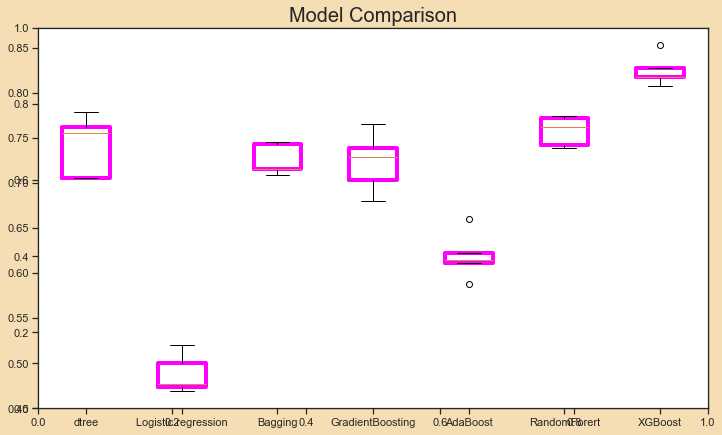

In [305]:

fig=plt.figure(figsize=(12,7),facecolor='wheat')#setting plot size
plt.title('Model Comparison',fontsize=20)#adding title
ax=fig.add_subplot(111)# add plots on the same graph
bp=plt.boxplot(results1)# plot cross validation results per model
ax.set_xticklabels(names)#add name labels to each model
for box in bp['boxes']:
    box.set(color='fuchsia', linewidth=4)
plt.show()



If we only check cross validation, XGboost is giving the best performance, followed by RandomForest. None of this model is reliable when it comes to predict class 1.

##### GENERAL PERFORMANCE ON TRAIN AND VALIDATION SETS FOR ORIGINAL DATA FOR EACH MODEL

In [423]:
'''CREATING DIFFERENT CLASSIFIERS TO FIT DIFFERENT MODELS. We are creating different classifiers 
in order to fit fifferent x_train sets.'''

dtree=DecisionTreeClassifier(random_state=1).fit(x_train,y_train)
Logistic_regression=LogisticRegression(random_state=1).fit(x_train,y_train)
Bagging=BaggingClassifier(random_state=1).fit(x_train,y_train)
GradientBoosting=GradientBoostingClassifier(random_state=1).fit(x_train,y_train)
AdaBoost= AdaBoostClassifier(random_state=1).fit(x_train,y_train)
RandomForert=RandomForestClassifier(random_state=1)
XGBoost= XGBClassifier(random_state=1,eval_metric='logloss')


In [395]:
models = []  # Empty list to store all the models
names = ["dtree","Logistic regression","Bagging","GradientBoosting","AdaBoost","RandomForert","XGBoost"]  #  list to store name of the models
perf_list=[]
# Appending models into the list
models.append(("dtree", DecisionTreeClassifier(random_state=1)))
models.append(("Logistic regression", LogisticRegression(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("GradientBoosting", GradientBoostingClassifier(random_state=1)))
models.append(("AdaBoost", AdaBoostClassifier(random_state=1)))
models.append(("RandomForert", RandomForestClassifier(random_state=1)))
models.append(("XGBoost", XGBClassifier(random_state=1,eval_metric='logloss')))
for name, model in models:
    model.fit(x_train, y_train)
    acc=np.round(accuracy_score(y_train,model.predict(x_train)),4)
    re=np.round(recall_score(y_train, model.predict(x_train)),4) 
    pr=np.round(precision_score(y_train, model.predict(x_train)),4)  
    f1=np.round(f1_score(y_train, model.predict(x_train)),4)
     # creating a dataframe of metrics
    df_perf = pd.DataFrame(
        {    'model': name,
            "Accuracy": acc,
            "Recall": re,
            "Precision": pr,
            "F1": f1
            
        },
        index=[0],
    )
 
    perf_list.append(df_perf)
    print('PERFORMANCE ON TRAIN SET')
    print(df_perf)
    print('********************')
   

PERFORMANCE ON TRAIN SET
   model  Accuracy  Recall  Precision    F1
0  dtree     1.000   1.000      1.000 1.000
********************
PERFORMANCE ON TRAIN SET
                 model  Accuracy  Recall  Precision    F1
0  Logistic regression     0.968   0.488      0.861 0.623
********************
PERFORMANCE ON TRAIN SET
     model  Accuracy  Recall  Precision    F1
0  Bagging     0.998   0.958      1.000 0.978
********************
PERFORMANCE ON TRAIN SET
              model  Accuracy  Recall  Precision    F1
0  GradientBoosting     0.987   0.782      0.980 0.870
********************
PERFORMANCE ON TRAIN SET
      model  Accuracy  Recall  Precision    F1
0  AdaBoost     0.976   0.627      0.898 0.739
********************
PERFORMANCE ON TRAIN SET
          model  Accuracy  Recall  Precision    F1
0  RandomForert     1.000   0.999      1.000 1.000
********************
PERFORMANCE ON TRAIN SET
     model  Accuracy  Recall  Precision    F1
0  XGBoost     1.000   1.000      1.000 1.000
*****

##### GENERAL PERFORMANCE ON VALIDATION SET FOR ORIGINAL DATA FOR EACH MODEL

In [411]:
models = []  # Empty list to store all the models
names = ["dtree","Logistic regression","Bagging","GradientBoosting","AdaBoost","RandomForert","XGBoost"]  #  list to store name of the models
perf_list1=[]
# Appending models into the list
models.append(("dtree", DecisionTreeClassifier(random_state=1)))
models.append(("Logistic regression", LogisticRegression(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("GradientBoosting", GradientBoostingClassifier(random_state=1)))
models.append(("AdaBoost", AdaBoostClassifier(random_state=1)))
models.append(("RandomForert", RandomForestClassifier(random_state=1)))
models.append(("XGBoost", XGBClassifier(random_state=1,eval_metric='logloss')))
for name, model in models:
    model.fit(x_train, y_train)
    acc=np.round(accuracy_score(y_val,model.predict(x_val)),4)
    re=np.round(recall_score(y_val, model.predict(x_val)),4) 
    pr=np.round(precision_score(y_val, model.predict(x_val)),4)  
    f1=np.round(f1_score(y_val, model.predict(x_val)),4)
     # creating a dataframe of metrics on validation set
    df_perf_val = pd.DataFrame(
        {    'model': name,
            "Accuracy": acc,
            "Recall": re,
            "Precision": pr,
            "F1": f1
            
        },
        index=[0],
    )
 
    perf_list1.append(df_perf_val)
    print('PERFORMANCE ON VALIDATION SET')
    print(df_perf_val)
    print('********************')
   

PERFORMANCE ON VALIDATION SET
   model  Accuracy  Recall  Precision    F1
0  dtree     0.971   0.745      0.724 0.735
********************
PERFORMANCE ON VALIDATION SET
                 model  Accuracy  Recall  Precision    F1
0  Logistic regression     0.965   0.463      0.828 0.594
********************
PERFORMANCE ON VALIDATION SET
     model  Accuracy  Recall  Precision    F1
0  Bagging     0.984   0.724      0.965 0.828
********************
PERFORMANCE ON VALIDATION SET
              model  Accuracy  Recall  Precision    F1
0  GradientBoosting     0.982   0.720      0.938 0.815
********************
PERFORMANCE ON VALIDATION SET
      model  Accuracy  Recall  Precision    F1
0  AdaBoost     0.972   0.605      0.831 0.700
********************
PERFORMANCE ON VALIDATION SET
          model  Accuracy  Recall  Precision    F1
0  RandomForert     0.987   0.764      0.988 0.862
********************
PERFORMANCE ON VALIDATION SET
     model  Accuracy  Recall  Precision    F1
0  XGBoost     0

- When comparing train and validation performance of each model, clearly dtree, Bagging, RamdomForest and XGBoost models are overfitted since those models perform much better on train set.
-Logistic regression and Adaboost model are performing very poorly but they are not overfitted.
-Gradient boosting recall is not good enough to guarantee a good prediction for turbine failure and it is slightly overfitted too.
-All models need to be enhanced to improve performance.
-These models are biased because we have a huge imbalance in the data, most of the data belong to class 0, so Cross validation is a much better indicator to analyze model performance.

### 2.Model building with original data using method2, KNN imputer (x_train2)

In [245]:
models = []  # Empty list to store all the models

# Appending models into the list
models.append(("dtree", DecisionTreeClassifier(random_state=1)))
models.append(("Logistic regression", LogisticRegression(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("GradientBoosting", GradientBoostingClassifier(random_state=1)))
models.append(("AdaBoost", AdaBoostClassifier(random_state=1)))
models.append(("RandomForest", RandomForestClassifier(random_state=1)))
models.append(("XGBoost", XGBClassifier(random_state=1,eval_metric='logloss')))


results2 = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation Cost:" "\n")

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=x_train2, y=y_train, scoring=scorer, cv=kfold
    )
    results2.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean()))

print("\n" "Validation Performance:" "\n")

for name, model in models:
    model.fit(x_train2, y_train)
    scores_validation = recall_score(y_val, model.predict(x_val2))
    print("{}: {}".format(name, scores_validation))
    print('******************************************')


Cross-Validation Cost:

dtree: 0.7393604564518533
Logistic regression: 0.48792872197739035
Bagging: 0.7250047901896916
GradientBoosting: 0.7217219135211088
AdaBoost: 0.6192012092567755
RandomForest: 0.7576674969662132
XGBoost: 0.8190606970258244

Validation Performance:

dtree: 0.7454268292682927
******************************************
Logistic regression: 0.4634146341463415
******************************************
Bagging: 0.711890243902439
******************************************
GradientBoosting: 0.7134146341463414
******************************************
AdaBoost: 0.6051829268292683
******************************************
RandomForest: 0.7652439024390244
******************************************
XGBoost: 0.8262195121951219
******************************************


- Models performance remains the same after checking all models with imputation method Simple Imputer and KNN Imputer. There is not a relevant difference. This is because we only had to impute data for two attributes, and we are working with a considerable big number of  values.
- Again, we can see how cross validation and validation recall are providing very similar results.


**Plotting cross validation results per model**

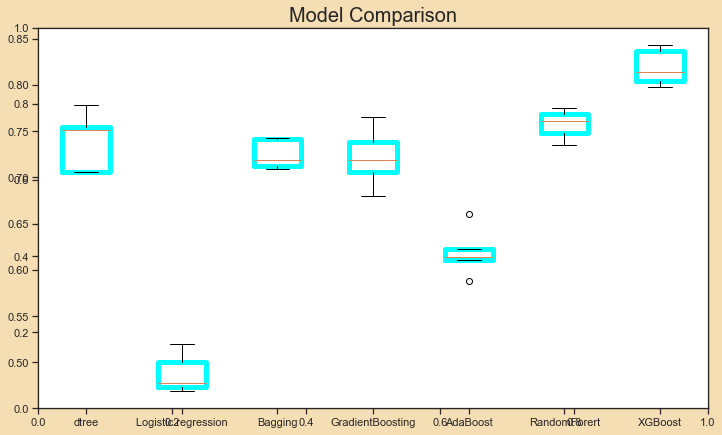

In [306]:

fig2=plt.figure(figsize=(12,7), facecolor='wheat')#setting plot size
plt.title('Model Comparison',fontsize=20)#adding title
ax2=fig2.add_subplot(111)# add plots on the same graph
bp=plt.boxplot(results2)# plot cross validation results per model
ax2.set_xticklabels(names)#add name labels to each model
for box in bp['boxes']:
    box.set(color='aqua', linewidth=5)
plt.show()


- The imputation method did not affect much the recall score neither on training nor cross validation. The first method seems to have slightly better performance on cross validation so we are going to used x_train instead of x_train2 and x_val instead of x_val2 to build our models.

- When comparing the data among the models, The XGBoosting is the one with better recall followed by Random Forest and dtree models.


##### GENERAL PERFORMANCE ON TRAIN AND VALIDATION SETS FOR ORIGINAL DATA  WITH KNN IMPUTER FOR EACH MODEL

In [410]:
models = []  # Empty list to store all the models
names = ["dtree","Logistic regression","Bagging","GradientBoosting","AdaBoost","RandomForert","XGBoost"]  #  list to store name of the models
perf_list2=[]
# Appending models into the list
models.append(("dtree", DecisionTreeClassifier(random_state=1)))
models.append(("Logistic regression", LogisticRegression(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("GradientBoosting", GradientBoostingClassifier(random_state=1)))
models.append(("AdaBoost", AdaBoostClassifier(random_state=1)))
models.append(("RandomForert", RandomForestClassifier(random_state=1)))
models.append(("XGBoost", XGBClassifier(random_state=1,eval_metric='logloss')))
for name, model in models:
    model.fit(x_train2, y_train)
    acc=np.round(accuracy_score(y_train,model.predict(x_train2)),4)
    re=np.round(recall_score(y_train, model.predict(x_train2)),4) 
    pr=np.round(precision_score(y_train, model.predict(x_train2)),4)  
    f1=np.round(f1_score(y_train, model.predict(x_train2)),4)
     # creating a dataframe of metrics
    df_perf2 = pd.DataFrame(
        {    'model': name,
            "Accuracy": acc,
            "Recall": re,
            "Precision": pr,
            "F1": f1
            
        },
        index=[0],
    )
 
    perf_list2.append(df_perf2)
    print('PERFORMANCE ON TRAIN SET KNN IMPUTER')
    print(df_perf2)
    print('********************')
   

PERFORMANCE ON TRAIN SET KNN IMPUTER
   model  Accuracy  Recall  Precision    F1
0  dtree     1.000   1.000      1.000 1.000
********************
PERFORMANCE ON TRAIN SET KNN IMPUTER
                 model  Accuracy  Recall  Precision    F1
0  Logistic regression     0.968   0.488      0.860 0.623
********************
PERFORMANCE ON TRAIN SET KNN IMPUTER
     model  Accuracy  Recall  Precision    F1
0  Bagging     0.998   0.957      1.000 0.978
********************
PERFORMANCE ON TRAIN SET KNN IMPUTER
              model  Accuracy  Recall  Precision    F1
0  GradientBoosting     0.987   0.779      0.983 0.869
********************
PERFORMANCE ON TRAIN SET KNN IMPUTER
      model  Accuracy  Recall  Precision    F1
0  AdaBoost     0.976   0.627      0.898 0.739
********************
PERFORMANCE ON TRAIN SET KNN IMPUTER
          model  Accuracy  Recall  Precision    F1
0  RandomForert     1.000   0.999      1.000 1.000
********************
PERFORMANCE ON TRAIN SET KNN IMPUTER
     model  A

##### GENERAL PERFORMANCE ON VALIDATION SET FOR ORIGINAL DATA WITH KNN IMPUTER FOR EACH MODEL

In [412]:
models = []  # Empty list to store all the models
names = ["dtree","Logistic regression","Bagging","GradientBoosting","AdaBoost","RandomForert","XGBoost"]  #  list to store name of the models
perf_list3=[]
# Appending models into the list
models.append(("dtree", DecisionTreeClassifier(random_state=1)))
models.append(("Logistic regression", LogisticRegression(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("GradientBoosting", GradientBoostingClassifier(random_state=1)))
models.append(("AdaBoost", AdaBoostClassifier(random_state=1)))
models.append(("RandomForert", RandomForestClassifier(random_state=1)))
models.append(("XGBoost", XGBClassifier(random_state=1,eval_metric='logloss')))
for name, model in models:
    model.fit(x_train2, y_train)
    acc=np.round(accuracy_score(y_val,model.predict(x_val2)),4)
    re=np.round(recall_score(y_val, model.predict(x_val2)),4) 
    pr=np.round(precision_score(y_val, model.predict(x_val2)),4)  
    f1=np.round(f1_score(y_val, model.predict(x_val2)),4)
     # creating a dataframe of metrics on validation set
    df_perf_val2 = pd.DataFrame(
        {    'model': name,
            "Accuracy": acc,
            "Recall": re,
            "Precision": pr,
            "F1": f1
            
        },
        index=[0],
    )
 
    perf_list.append(df_perf_val2)
    print('PERFORMANCE ON VALIDATION SET KNN IMPUTER')
    print(df_perf_val2)
    print('********************')
   

PERFORMANCE ON VALIDATION SET KNN IMPUTER
   model  Accuracy  Recall  Precision    F1
0  dtree     0.971   0.745      0.724 0.735
********************
PERFORMANCE ON VALIDATION SET KNN IMPUTER
                 model  Accuracy  Recall  Precision    F1
0  Logistic regression     0.965   0.463      0.828 0.594
********************
PERFORMANCE ON VALIDATION SET KNN IMPUTER
     model  Accuracy  Recall  Precision    F1
0  Bagging     0.983   0.712      0.967 0.820
********************
PERFORMANCE ON VALIDATION SET KNN IMPUTER
              model  Accuracy  Recall  Precision    F1
0  GradientBoosting     0.982   0.713      0.932 0.808
********************
PERFORMANCE ON VALIDATION SET KNN IMPUTER
      model  Accuracy  Recall  Precision    F1
0  AdaBoost     0.972   0.605      0.831 0.700
********************
PERFORMANCE ON VALIDATION SET KNN IMPUTER
          model  Accuracy  Recall  Precision    F1
0  RandomForert     0.987   0.765      0.986 0.862
********************
PERFORMANCE ON VALID

- Some of the model’s performance is very poor as Logistic regression and Adaboost models. Gradient boosting performance is not good enough either.
- For most of the models we can see a trend to overfitting since the recall score performance is much better on training data. That will be the case for XGBoost, RamdomForest, Bagging, and dtree.
- These models are biased so they will tend to improve recall by minimizing misclassification on class0, but we are interested in minimizing misclassification in class1.


## 6.3 Model Building with Oversampled data


In [359]:
# Synthetic Minority Over Sampling Technique
sm = SMOTE(sampling_strategy=1, k_neighbors=5, random_state=1)
x_train_over, y_train_over = sm.fit_resample(x_train, y_train)

In [360]:
print(f'x_train before oversampling contains {x_train.shape[0]} rows and {x_train.shape[1]} columns')

x_train before oversampling contains 28000 rows and 40 columns


In [361]:
print(f'x_train after oversampling contains {x_train_over.shape[0]} rows and {x_train_over.shape[1]} columns')

x_train after oversampling contains 52938 rows and 40 columns


In [362]:
print(f'y_train before oversampling contains {y_train.shape} rows')

y_train before oversampling contains (28000,) rows


In [363]:
print(f'y_train_over after oversampling contains {y_train_over.shape} rows')

y_train_over after oversampling contains (52938,) rows


In [364]:
y_train.value_counts(normalize=True)

0   0.945
1   0.055
Name: Target, dtype: float64

In [365]:
y_train_over.value_counts(normalize=True)

0   0.500
1   0.500
Name: Target, dtype: float64

In [366]:
#number of new rows created
52938-28000

24938

- SMOTE is a technique that permits us to create synthetic data for the imbalanced dataset. It will create data point by using the nearest neighbors technique (in this case we are using the nearest neighbors) for the class with less weight, in this case for class 1.
- After oversampling the SMOTE mothod has created 24938 synthetic rows and now we have equal proportion of each class( 50% class1 and 50% class0)

In [370]:
models = []  # Empty list to store all the models

# Appending models into the list
models.append(("dtree", DecisionTreeClassifier(random_state=1)))
models.append(("Logistic regression", LogisticRegression(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("GradientBoosting", GradientBoostingClassifier(random_state=1)))
models.append(("AdaBoost", AdaBoostClassifier(random_state=1)))
models.append(("RandomForert", RandomForestClassifier(random_state=1)))
models.append(("XGBoost", XGBClassifier(random_state=1,eval_metric='logloss')))



results_over = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation Cost:" "\n")

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=x_train_over, y=y_train_over, scoring=scorer, cv=kfold
    )
    results_over.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean()))

print("\n" " Validation Performance:" "\n")

for name, model in models:
    model.fit(x_train_over, y_train_over)
    scores_validation_over = recall_score(y_val, model.predict(x_val))
    print("{}: {}".format(name, scores_validation_over))
    print('************************************************')


Cross-Validation Cost:

dtree: 0.9689069274906782
Logistic regression: 0.8747214299831179
Bagging: 0.9747252485284147
GradientBoosting: 0.9163928365232223
AdaBoost: 0.8942159673577901
RandomForert: 0.9812233634160948
XGBoost: 0.9851525537396013

 Validation Performance:

dtree: 0.8125
************************************************
Logistic regression: 0.8399390243902439
************************************************
Bagging: 0.8414634146341463
************************************************
GradientBoosting: 0.8765243902439024
************************************************
AdaBoost: 0.8536585365853658
************************************************
RandomForert: 0.8612804878048781
************************************************
XGBoost: 0.875
************************************************


- With oversampling technique, we have corrected the imbalanced data, so we have same proportion for each class. 
- Cross validation and validation performance are so similar for some of the models such as Bagging.Cross validation is a better performance evaluator than validation because it uses more data to build the metrics.
-XGBoost followed from RandomForest and Bagging are the best models in terms of recall score.


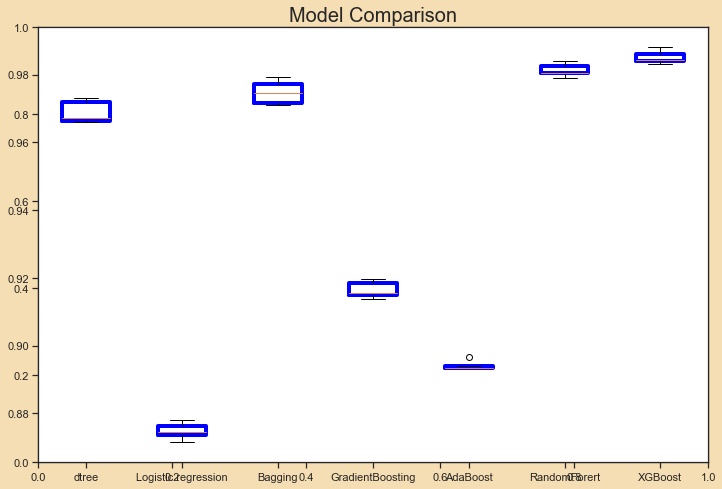

In [371]:

fig3=plt.figure(figsize=(12,8), facecolor='wheat')#setting plot size
plt.title('Model Comparison',fontsize=20)#adding title
ax3=fig3.add_subplot(111)# add plots on the same graph
bp_over=plt.boxplot(results_over)# plot cross validation results per model
ax3.set_xticklabels(names)#add name labels to each model
for box in bp_over['boxes']:
    box.set(color='blue', linewidth=4)

plt.show()

- As we initially explained, the best model according to cross validation method in terms of recall score is XGBoost.



##### GENERAL PERFORMANCE ON TRAIN SET  FOR EACH MODEL WITH OVERSAMPLING

In [445]:
models = []  # Empty list to store all the models
names = ["dtree","Logistic regression","Bagging","GradientBoosting","AdaBoost","RandomForert","XGBoost"]  #  list to store name of the models
perf_list_over=[]
# Appending models into the list
models.append(("dtree", DecisionTreeClassifier(random_state=1)))
models.append(("Logistic regression", LogisticRegression(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("GradientBoosting", GradientBoostingClassifier(random_state=1)))
models.append(("AdaBoost", AdaBoostClassifier(random_state=1)))
models.append(("RandomForert", RandomForestClassifier(random_state=1)))
models.append(("XGBoost", XGBClassifier(random_state=1,eval_metric='logloss')))
for name, model in models:
    model.fit(x_train_over, y_train_over)
    acc=np.round(accuracy_score(y_train_over,model.predict(x_train_over)),4)
    re=np.round(recall_score(y_train_over, model.predict(x_train_over)),4) 
    pr=np.round(precision_score(y_train_over, model.predict(x_train_over)),4)  
    f1=np.round(f1_score(y_train_over, model.predict(x_train_over)),4)
     # creating a dataframe of metrics
    df_perf_over = pd.DataFrame(
        {    'model': name,
            "Accuracy": acc,
            "Recall": re,
            "Precision": pr,
            "F1": f1
            
        },
        index=[0],
    )
 
    perf_list_over.append(df_perf_over)
    print('PERFORMANCE ON TRAIN SET WITH OVERSAMPLING')
    print(df_perf_over)
    print('********************')
   

PERFORMANCE ON TRAIN SET WITH OVERSAMPLING
   model  Accuracy  Recall  Precision    F1
0  dtree     1.000   1.000      1.000 1.000
********************
PERFORMANCE ON TRAIN SET WITH OVERSAMPLING
                 model  Accuracy  Recall  Precision    F1
0  Logistic regression     0.874   0.875      0.873 0.874
********************
PERFORMANCE ON TRAIN SET WITH OVERSAMPLING
     model  Accuracy  Recall  Precision    F1
0  Bagging     0.999   0.999      1.000 0.999
********************
PERFORMANCE ON TRAIN SET WITH OVERSAMPLING
              model  Accuracy  Recall  Precision    F1
0  GradientBoosting     0.945   0.918      0.971 0.944
********************
PERFORMANCE ON TRAIN SET WITH OVERSAMPLING
      model  Accuracy  Recall  Precision    F1
0  AdaBoost     0.907   0.898      0.915 0.906
********************
PERFORMANCE ON TRAIN SET WITH OVERSAMPLING
          model  Accuracy  Recall  Precision    F1
0  RandomForert     1.000   1.000      1.000 1.000
********************
PERFORMANCE ON

##### GENERAL PERFORMANCE ON VALIDATION SET  FOR EACH MODEL WITH OVERSAMPLING

In [424]:
models = []  # Empty list to store all the models
names = ["dtree","Logistic regression","Bagging","GradientBoosting","AdaBoost","RandomForert","XGBoost"]  #  list to store name of the models
perf_list_over2=[]
# Appending models into the list
models.append(("dtree", DecisionTreeClassifier(random_state=1)))
models.append(("Logistic regression", LogisticRegression(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("GradientBoosting", GradientBoostingClassifier(random_state=1)))
models.append(("AdaBoost", AdaBoostClassifier(random_state=1)))
models.append(("RandomForert", RandomForestClassifier(random_state=1)))
models.append(("XGBoost", XGBClassifier(random_state=1,eval_metric='logloss')))
for name, model in models:
    model.fit(x_train_over, y_train_over)
    acc=np.round(accuracy_score(y_val,model.predict(x_val)),4)
    re=np.round(recall_score(y_val, model.predict(x_val)),4) 
    pr=np.round(precision_score(y_val, model.predict(x_val)),4)  
    f1=np.round(f1_score(y_val, model.predict(x_val)),4)
     # creating a dataframe of metrics on validation set
    df_perf_val_over = pd.DataFrame(
        {    'model': name,
            "Accuracy": acc,
            "Recall": re,
            "Precision": pr,
            "F1": f1
            
        },
        index=[0],
    )
 
    perf_list_over2.append(df_perf_val_over)
    print('PERFORMANCE ON VALIDATION SET WITH OVERSAMPLING')
    print(df_perf_val_over)
    print('********************')
   

PERFORMANCE ON VALIDATION SET WITH OVERSAMPLING
   model  Accuracy  Recall  Precision    F1
0  dtree     0.948   0.812      0.514 0.630
********************
PERFORMANCE ON VALIDATION SET WITH OVERSAMPLING
                 model  Accuracy  Recall  Precision    F1
0  Logistic regression     0.873   0.840      0.279 0.419
********************
PERFORMANCE ON VALIDATION SET WITH OVERSAMPLING
     model  Accuracy  Recall  Precision    F1
0  Bagging     0.984   0.842      0.860 0.851
********************
PERFORMANCE ON VALIDATION SET WITH OVERSAMPLING
              model  Accuracy  Recall  Precision    F1
0  GradientBoosting     0.966   0.876      0.639 0.739
********************
PERFORMANCE ON VALIDATION SET WITH OVERSAMPLING
      model  Accuracy  Recall  Precision    F1
0  AdaBoost     0.908   0.854      0.357 0.504
********************
PERFORMANCE ON VALIDATION SET WITH OVERSAMPLING
          model  Accuracy  Recall  Precision    F1
0  RandomForert     0.990   0.861      0.953 0.905
*****


- We still face some overfitting issues with some of the models, but the recall scores on training and validation is closer than in the original data.
- The problem with SMOTE and oversampling in general, it is the tendency to overfit the models.
- Model dtree is overfitting the data, as well as RandomForest, Baggingand XGBoost where the training set recall is much better that the recall in validation set.
- We will try treat overfitting by using hyper parameters and tuning the models.
- Models Adaboost, Gradientboosting and logistic regression are giving a decent recall, especially Gradient Boosting.



## 6.4 Model Building with Undersampled data

In [54]:
# Random undersampler for under sampling the data
rus = RandomUnderSampler(random_state=1, sampling_strategy=1)
x_train_under, y_train_under = rus.fit_resample(x_train, y_train)

In [55]:
print(f'x_train before undersampling contains {x_train.shape[0]} rows and {x_train.shape[1]} columns')

x_train before undersampling contains 28000 rows and 40 columns


In [56]:
print(f'x_train after undersampling contains {x_train_under.shape[0]} rows and {x_train_under.shape[1]} columns')

x_train after undersampling contains 3062 rows and 40 columns


In [57]:
print(f'y_train before undersampling contains {y_train.shape} rows')

y_train before undersampling contains (28000,) rows


In [58]:
print(f'y_train_over after undersampling contains {y_train_under.shape} rows')

y_train_over after undersampling contains (3062,) rows


In [59]:
y_train.value_counts(normalize=True)

0   0.945
1   0.055
Name: Target, dtype: float64

In [60]:
y_train_under.value_counts(normalize=True)

0   0.500
1   0.500
Name: Target, dtype: float64

In [61]:
#Number of rows deleted after under sampling
28000-3062

24938

- Random simple undersampling is a method that take random data and eliminate it for set to deal with the imbalance. In this case as we set strategy to 1 we are asking for same proportion of both classes on data set. 
- We can see how the number of rows has decrease considerably and we have dealt with the imbalanced data but also lost lots of information (24938 rows are not part of our data anymore).
- Both classes are now present on the dataset in same proportion.


In [312]:
models = []  # Empty list to store all the models

# Appending models into the list
models.append(("dtree", DecisionTreeClassifier(random_state=1)))
models.append(("Logistic_regression", LogisticRegression(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("GradientBoosting", GradientBoostingClassifier(random_state=1)))
models.append(("AdaBoost", AdaBoostClassifier(random_state=1)))
models.append(("RandomForert", RandomForestClassifier(random_state=1)))
models.append(("XGBoost", XGBClassifier(random_state=1,eval_metric='logloss')))



results_under = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation Cost:" "\n")

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=x_train_under, y=y_train_under, scoring=scorer, cv=kfold
    )
    results_over.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean()))

print("\n" "Validation Performance:" "\n")

for name, model in models:
    model.fit(x_train_under, y_train_under)
    scores_train_under= recall_score(y_train_under, model.predict(x_train_under))
    print("{}: {}".format(name, scores_train_under))
    print('************************************************')


Cross-Validation Cost:

dtree: 0.8510804538970854
Logistic_regression: 0.8517063720167763
Bagging: 0.8706691362755743
GradientBoosting: 0.8850354474037172
AdaBoost: 0.8602243937748824
RandomForert: 0.8948414979455409
XGBoost: 0.8941793872815141

Validation Performance:

dtree: 1.0
************************************************
Logistic_regression: 0.8517308948399739
************************************************
Bagging: 0.977139124755062
************************************************
GradientBoosting: 0.9157413455258001
************************************************
AdaBoost: 0.8817766165904638
************************************************
RandomForert: 1.0
************************************************
XGBoost: 1.0
************************************************


- Cross validation is a better evaluator than performance on train validation set. The values differ slightly.
- Models RamdonForest and XGboost have the best performance but it is not as good at the recall score that SMOTE tecnique shows.



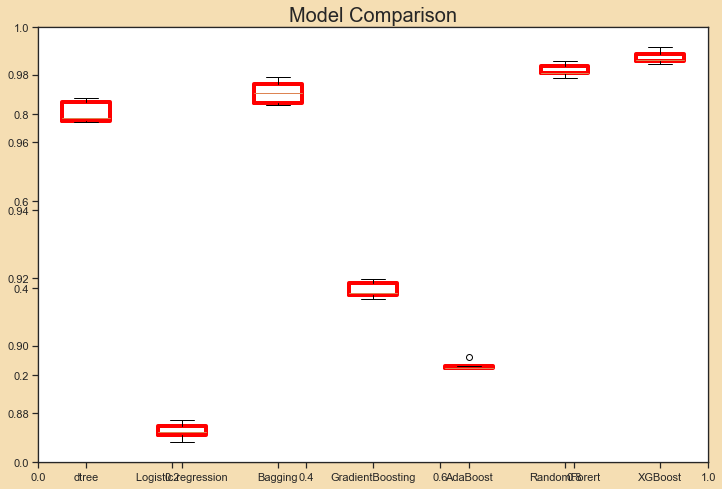

In [372]:

fig4=plt.figure(figsize=(12,8), facecolor='wheat')#setting plot size
plt.title('Model Comparison',fontsize=20)#adding title
ax4=fig4.add_subplot(111)# add plots on the same graph
bp_under=plt.boxplot(results_over)# plot cross validation results per model
ax4.set_xticklabels(names)#add name labels to each model
for box in bp_under['boxes']:
    box.set(color='red', linewidth=4)

plt.show()


- As Cross validation method is the average of the recall score for each of the 5 folds left out of train data when fitting the model, we have 5 different results for each model, so that is why we can see some boxplots with whiskers.
- As per cross validation method, recall score is best for XGBoost, followed by RandomForest but as we know those models are overfitted.


In [190]:
##### GENERAL PERFORMANCE ON TRAIN SET WITH UNDERSAMPLING FOR EACH MODEL

In [447]:
models = []  # Empty list to store all the models
names = ["dtree","Logistic regression","Bagging","GradientBoosting","AdaBoost","RandomForert","XGBoost"]  #  list to store name of the models
perf_list_under=[]
# Appending models into the list
models.append(("dtree", DecisionTreeClassifier(random_state=1)))
models.append(("Logistic regression", LogisticRegression(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("GradientBoosting", GradientBoostingClassifier(random_state=1)))
models.append(("AdaBoost", AdaBoostClassifier(random_state=1)))
models.append(("RandomForert", RandomForestClassifier(random_state=1)))
models.append(("XGBoost", XGBClassifier(random_state=1,eval_metric='logloss')))
for name, model in models:
    model.fit(x_train_under, y_train_under)
    acc=np.round(accuracy_score(y_train_under,model.predict(x_train_under)),4)
    re=np.round(recall_score(y_train_under, model.predict(x_train_under)),4) 
    pr=np.round(precision_score(y_train_under, model.predict(x_train_under)),4)  
    f1=np.round(f1_score(y_train_under, model.predict(x_train_under)),4)
     # creating a dataframe of metrics
    df_perf_under = pd.DataFrame(
        {    'model': name,
            "Accuracy": acc,
            "Recall": re,
            "Precision": pr,
            "F1": f1
            
        },
        index=[0],
    )
 
    perf_list_under.append(df_perf_under)
    print('PERFORMANCE ON TRAIN SET WITH UNDERSAMPLING')
    print(df_perf_under)
    print('********************')
   

PERFORMANCE ON TRAIN SET WITH UNDERSAMPLING
   model  Accuracy  Recall  Precision    F1
0  dtree     1.000   1.000      1.000 1.000
********************
PERFORMANCE ON TRAIN SET WITH UNDERSAMPLING
                 model  Accuracy  Recall  Precision    F1
0  Logistic regression     0.854   0.852      0.856 0.854
********************
PERFORMANCE ON TRAIN SET WITH UNDERSAMPLING
     model  Accuracy  Recall  Precision    F1
0  Bagging     0.987   0.977      0.997 0.987
********************
PERFORMANCE ON TRAIN SET WITH UNDERSAMPLING
              model  Accuracy  Recall  Precision    F1
0  GradientBoosting     0.950   0.916      0.983 0.948
********************
PERFORMANCE ON TRAIN SET WITH UNDERSAMPLING
      model  Accuracy  Recall  Precision    F1
0  AdaBoost     0.907   0.882      0.928 0.904
********************
PERFORMANCE ON TRAIN SET WITH UNDERSAMPLING
          model  Accuracy  Recall  Precision    F1
0  RandomForert     1.000   1.000      1.000 1.000
********************
PERFORMA

In [530]:
##### GENERAL PERFORMANCE ON VALIDATION SET WITH UNDERSAMPLING FOR EACH MODEL

In [450]:
models = []  # Empty list to store all the models
names = ["dtree","Logistic regression","Bagging","GradientBoosting","AdaBoost","RandomForert","XGBoost"]  #  list to store name of the models
perf_list_under2=[]
# Appending models into the list
models.append(("dtree", DecisionTreeClassifier(random_state=1)))
models.append(("Logistic regression", LogisticRegression(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("GradientBoosting", GradientBoostingClassifier(random_state=1)))
models.append(("AdaBoost", AdaBoostClassifier(random_state=1)))
models.append(("RandomForert", RandomForestClassifier(random_state=1)))
models.append(("XGBoost", XGBClassifier(random_state=1,eval_metric='logloss')))
for name, model in models:
    model.fit(x_train_under, y_train_under)
    acc=np.round(accuracy_score(y_val,model.predict(x_val)),4)
    re=np.round(recall_score(y_val, model.predict(x_val)),4) 
    pr=np.round(precision_score(y_val, model.predict(x_val)),4)  
    f1=np.round(f1_score(y_val, model.predict(x_val)),4)
     # creating a dataframe of metrics on validation set
    df_perf_val_under = pd.DataFrame(
        {    'model': name,
            "Accuracy": acc,
            "Recall": re,
            "Precision": pr,
            "F1": f1
            
        },
        index=[0],
    )
 
    perf_list_under2.append(df_perf_val_under)
    print('PERFORMANCE ON VALIDATION SET WITH UNDERSAMPLING')
    print(df_perf_val_under)
    print('********************')
   

PERFORMANCE ON VALIDATION SET WITH UNDERSAMPLING
   model  Accuracy  Recall  Precision    F1
0  dtree     0.853   0.838      0.249 0.385
********************
PERFORMANCE ON VALIDATION SET WITH UNDERSAMPLING
                 model  Accuracy  Recall  Precision    F1
0  Logistic regression     0.867   0.837      0.270 0.408
********************
PERFORMANCE ON VALIDATION SET WITH UNDERSAMPLING
     model  Accuracy  Recall  Precision    F1
0  Bagging     0.948   0.867      0.514 0.645
********************
PERFORMANCE ON VALIDATION SET WITH UNDERSAMPLING
              model  Accuracy  Recall  Precision    F1
0  GradientBoosting     0.948   0.876      0.516 0.649
********************
PERFORMANCE ON VALIDATION SET WITH UNDERSAMPLING
      model  Accuracy  Recall  Precision    F1
0  AdaBoost     0.896   0.863      0.330 0.477
********************
PERFORMANCE ON VALIDATION SET WITH UNDERSAMPLING
          model  Accuracy  Recall  Precision    F1
0  RandomForert     0.966   0.887      0.631 0.738

- Under sampling is not helping the data when it comes to overfitting.
- We still have some model that perform better on train than on validation set, that is the case of RandomForest, XGboost, Bagging and dtree.
- Cross validation recall score and recall performed on validation set are providing similar results.
- Grandient booosting is giving us a great recall score followed by Adaboost, but precission is really bad.
- Logistic regression recall is not as good as the previous ones but still acceptable, precision on the other hand is not that good.
- The problem with downsampling is that we lost lots of data that are helpful to construct our model.Overfitting is still an issue.

## 6.5 Choosing the three best models


- The best models in our case are the ones that provide with higher recall score.
- Most of the models are overfitted, so we need to work with the hyperparameters in order to fix the issue.
- Since cross validation is a better indicator that performance in validation set, we are choosing the models with higher recall cross validation.
- In order to fix the imbalanced data, we are using the oversampling method, since it is preferable to the undersampling in order to avoid losing information.
- We are also facing the curse of dimensionality since we have so many variables and not enough number of values. We should try to use lasso or any type of regularization to diminish overfitting.

The three best models for oversampled data are : XGboost, RamdonForest and Bagging with the highst recall scores on cross validation in the mentioned order.
Below we can see the Recall score for the three models: 
* XGBoost: 0.8941793872815141
* RandomForert: 0.8948414979455409
* Bagging: 0.8706691362755743

We are also tuning oversampled logistic_regresion model and GradientBoosting in order to try to reduce ovefitting with hyper parameter tuning.



## 7. HyperparameterTuning 

### Sample Parameter Grids

**Hyperparameter tuning can take a long time to run, so to avoid that time complexity - you can use the following grids, wherever required.**

- For Gradient Boosting:

param_grid = {
    "n_estimators": np.arange(100,150,25),
    "learning_rate": [0.2, 0.05, 1],
    "subsample":[0.5,0.7], 
    "max_features":[0.5,0.7]
}

- For Adaboost:

param_grid = {
    "n_estimators": [100, 150, 200],
    "learning_rate": [0.2, 0.05],
    "base_estimator": [DecisionTreeClassifier(max_depth=1, random_state=1), DecisionTreeClassifier(max_depth=2, random_state=1), DecisionTreeClassifier(max_depth=3, random_state=1),
    ]
}

- For Bagging Classifier:

param_grid = {
    'max_samples': [0.8,0.9,1], 
    'max_features': [0.7,0.8,0.9],
    'n_estimators' : [30,50,70],
}

- For Random Forest:

param_grid = {
    "n_estimators": [200,250,300],
    "min_samples_leaf": np.arange(1, 4),
    "max_features": [np.arange(0.3, 0.6, 0.1),'sqrt'],
    "max_samples": np.arange(0.4, 0.7, 0.1)
}

- For Decision Trees:

param_grid = {
    'max_depth': np.arange(2,6), 
    'min_samples_leaf': [1, 4, 7],
    'max_leaf_nodes' : [10, 15],
    'min_impurity_decrease': [0.0001,0.001]
}

- For Logistic Regression:

param_grid = {'C': np.arange(0.1,1.1,0.1)}

- For XGBoost:

param_grid={
    'n_estimators': [150, 200, 250],
    'scale_pos_weight': [5,10],
    'learning_rate': [0.1,0.2],
    'gamma': [0,3,5],
    'subsample': [0.8,0.9]
}

##  a. Tuning method for XGBosster with oversampled data
We have created three different XGBoosting models in order to improve performance with  different hyper parameters.

### Model XGB_tuned3

In [525]:
%%time
# defining model
Model_XGB = XGBClassifier(random_state=1,eval_metric='logloss')

# Parameter grid to pass in RandomSearchCV
param_grid={ 'n_estimators': [150, 200],'max_depth':[6,3,4], 'eta': [0.1,0.05], 'gamma': [0,3,5],'lambda':[0.5,0.2,0.9] }

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model_XGB , param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=5, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(x_train_over,y_train_over)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'n_estimators': 150, 'max_depth': 6, 'lambda': 0.9, 'gamma': 5, 'eta': 0.1} with CV score=0.960746574854087:
Wall time: 16min 36s


In [114]:
XGB_tuned3=XGBClassifier(random_state=1,eval_metric='logloss',n_estimators= 150, max_depth= 6, reg_lambda= 0.9, gamma= 5, eta= 0.1)

XGB_tuned3.fit(x_train_over,y_train_over)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              eta=0.1, eval_metric='logloss', gamma=5, gpu_id=-1,
              importance_type=None, interaction_constraints='',
              learning_rate=0.100000001, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=150, n_jobs=8, num_parallel_tree=1, predictor='auto',
              random_state=1, reg_alpha=0, reg_lambda=0.9, scale_pos_weight=1,
              subsample=1, tree_method='exact', validate_parameters=1,
              verbosity=None)

In [212]:
XGB_train3=model_performance_classification_sklearn(XGB_tuned3, x_train_over,y_train_over)
XGB_train3

,Accuracy,Recall,Precision,F1
0,0.987,0.978,0.996,0.987


In [213]:
XGB_val3=model_performance_classification_sklearn(XGB_tuned3, x_val,y_val)
XGB_val3

,Accuracy,Recall,Precision,F1
0,0.988,0.883,0.889,0.886


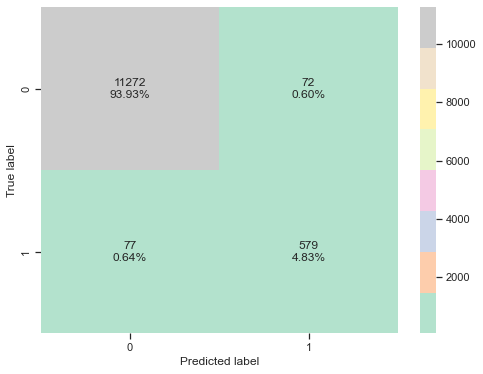

In [559]:
confusion_matrix_sklearn(XGB_tuned3,  x_val,y_val)

- We have provided parameter for searching that can control overfitting such as reg_lambda, that allows regularization and a limited number of trees. Low learning rate is also another way to control overfitting.
- Random Search has return a reg_lambda 0.9, maximum depth of each tree is six, very slow learning rete, 0.01 and 150 trees to be part of the model.

- Recall on validation set is a bit smaller but compared with the rest of the models it performs well. High accuracy and precision is quite good as well.
- The confusion matrix is showing the number of wrong prediction for class 1 is only 0.64 per cent, which is a great number. only 0.64 percent of the turbines that will need replacement will be misclassified as in good shape.

### Model XGB_tuned2

In [476]:
%%time
# defining model
Model_XGB = XGBClassifier(random_state=1,eval_metric='logloss')

# Parameter grid to pass in RandomSearchCV
param_grid={ 'n_estimators': [150, 200, 250],'max_depth':[6,3,4],'scale_pos_weight': [5,10], 'learning_rate': [0.1,0.2], 'gamma': [0,3,5] }

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model_XGB , param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=5, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(x_train_over,y_train_over)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'scale_pos_weight': 10, 'n_estimators': 150, 'max_depth': 6, 'learning_rate': 0.2, 'gamma': 3} with CV score=0.9947108008660033:
Wall time: 16min 53s


In [117]:
XGB_tuned2=XGBClassifier(random_state=1,eval_metric='logloss',scale_pos_weight=10, n_estimators= 150, max_depth= 6, learning_rate= 0.2, gamma= 3)

XGB_tuned2.fit(x_train_over,y_train_over)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              eval_metric='logloss', gamma=3, gpu_id=-1, importance_type=None,
              interaction_constraints='', learning_rate=0.2, max_delta_step=0,
              max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=150, n_jobs=8,
              num_parallel_tree=1, predictor='auto', random_state=1,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=10, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [214]:
XGB_train2=model_performance_classification_sklearn(XGB_tuned2, x_train_over,y_train_over)
XGB_train2

,Accuracy,Recall,Precision,F1
0,0.997,1.000,0.993,0.997


In [215]:
XGB_val2=model_performance_classification_sklearn(XGB_tuned2, x_val,y_val)
XGB_val2

,Accuracy,Recall,Precision,F1
0,0.978,0.892,0.753,0.816


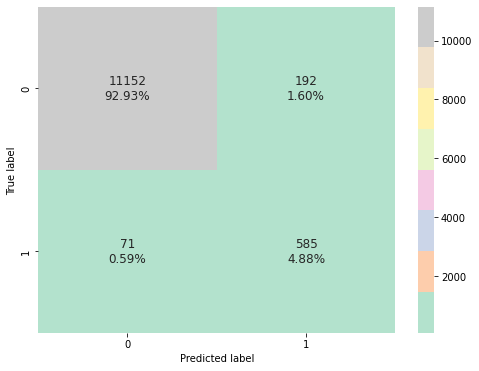

In [237]:
 confusion_matrix_sklearn(XGB_tuned2,  x_val,y_val)

- Model GXB_tuned2 is using the default reg_lambda and try to control overfitting with other parameters as small learning rate, small number of level per tree, which is 6 in this case and gamma 3.
- In this case, recall is higher than in the other model, but precision is not as good, The model XGB_tuned2 is also a bit overfitted. Precision and recall on train seem to do better than on validation.
- In this case the misclassification error for class1 is smaller than in the first model but type I error increases. 

### Model XGB_tuned

In [541]:
%%time
# defining model
Model_XGB0 = XGBClassifier(random_state=1,eval_metric='logloss')

# Parameter grid to pass in RandomSearchCV
param_grid={ 'n_estimators': [150, 200, 250], 'scale_pos_weight': [5,10], 'learning_rate': [0.1,0.2], 'gamma': [0,3,5], 'subsample': [0.8,0.9] }
#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model_XGB0, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=5, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(x_train_over,y_train_over)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'subsample': 0.8, 'scale_pos_weight': 10, 'n_estimators': 200, 'learning_rate': 0.1, 'gamma': 5} with CV score=0.9955797304763667:
Wall time: 23min 20s


In [120]:
#BUILDING THE MODEL WITH THE BEST PARAMETERS
XGB_tuned=XGBClassifier(random_state=1,eval_metric='logloss',subsample= 0.8, scale_pos_weight=10, n_estimators=200, learning_rate=0.1, gamma= 5)

XGB_tuned.fit(x_train_over,y_train_over)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              eval_metric='logloss', gamma=5, gpu_id=-1, importance_type=None,
              interaction_constraints='', learning_rate=0.1, max_delta_step=0,
              max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=200, n_jobs=8,
              num_parallel_tree=1, predictor='auto', random_state=1,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=10, subsample=0.8,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [216]:
XGB_train=model_performance_classification_sklearn(XGB_tuned, x_train_over,y_train_over)
XGB_train

,Accuracy,Recall,Precision,F1
0,0.991,1.000,0.982,0.991


In [122]:
XGB_val=model_performance_classification_sklearn(XGB_tuned, x_val, y_val)
XGB_val

,Accuracy,Recall,Precision,F1
0,0.968,0.898,0.647,0.752


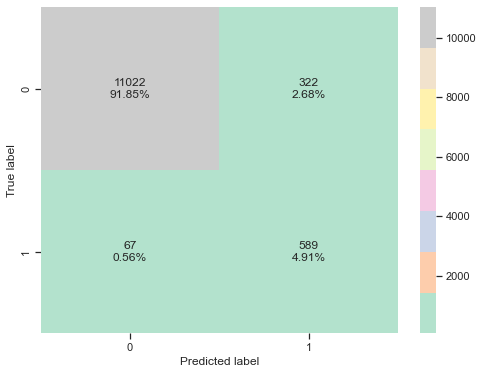

In [561]:
confusion_matrix_sklearn(XGB_tuned,  x_val,y_val)

- This model is giving the best recall and cross validation recall is providing with a very high number 0.99 for recall score.
- The variables chosen are 200 trees, 0.8 subsamples is indicating the proportion of train values chosen for training the model, and scale_post_weight 0.8 is helping with the imbalanced data.
- This model has the best Recall but precision is not as good. On the other hand, we can see how the parameters did not fix the tendency to overfit.
- The confussion matrix shows a very small percentage for class 1 misclassifiction but a bit higher for class 0 than the other models.

## b.Tuning RandomForest with oversampled data
We have created two ramdon forest models to compare the results of the hyper paremeters with the goal of control overfitting.

### Model rf_tuned

In [542]:
%%time
# defining model
Model_rf = RandomForestClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = { "n_estimators": [200,250,300], "min_samples_leaf": np.arange(1, 4), "max_features": [np.arange(0.3, 0.6, 0.1),'sqrt'], "max_samples": np.arange(0.4, 0.7, 0.1) }
#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model_rf , param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=5, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(x_train_over,y_train_over)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'n_estimators': 300, 'min_samples_leaf': 1, 'max_samples': 0.6, 'max_features': 'sqrt'} with CV score=0.9778608951769346:
Wall time: 9min 29s


In [123]:
#BUILDING MODEL WITH THE BEST PARAMETERS
rf_tuned=RandomForestClassifier(random_state=1,n_estimators= 300, min_samples_leaf= 1, max_samples=0.6, max_features='sqrt')
rf_tuned.fit(x_train_over,y_train_over)

RandomForestClassifier(max_features='sqrt', max_samples=0.6, n_estimators=300,
                       random_state=1)

In [217]:
rf_train=model_performance_classification_sklearn(rf_tuned, x_train_over,y_train_over)
rf_train

,Accuracy,Recall,Precision,F1
0,1.000,1.000,1.000,1.000


In [218]:
rf_val=model_performance_classification_sklearn(rf_tuned, x_val,y_val)
rf_val

,Accuracy,Recall,Precision,F1
0,0.990,0.866,0.947,0.904


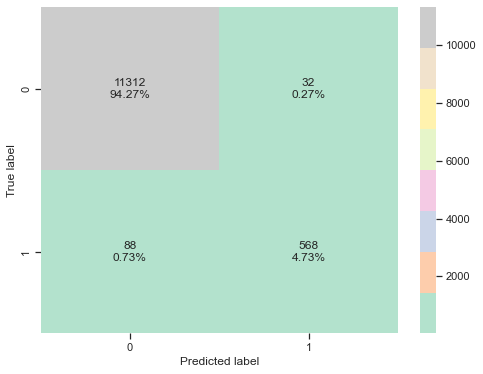

In [562]:
confusion_matrix_sklearn(rf_tuned,  x_val,y_val)

- The models metrics show signs of overfitting. There is a important gap between the recall in the train and validation set. The model on train set it capturing noise. 
- Model RF_tuned hyper parameters provided by the Randomized search tool are 300 trees, maximum number of features are 6 or squared root of 41 (number of columns).
- The number of false negative for class 1 is slightly higher than in the XG boosting models with 0.7% of wrong predictions for the damaged turbines. Precision seems to improved.

### Model rf_tuned2

In [194]:
%%time
# defining model
Model_rf = RandomForestClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = { "n_estimators": [100,200], "max_features": np.arange(0.1, 0.5, 0.2), 'min_impurity_decrease': (0.1,0.2,0.05) }
#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model_rf , param_distributions=param_grid, n_iter=15, n_jobs = -1, scoring=scorer, cv=5, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(x_train_over,y_train_over)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'n_estimators': 100, 'min_impurity_decrease': 0.05, 'max_features': 0.1} with CV score=0.8528091039258857:
Wall time: 2min 27s


In [195]:
#BUILDING MODEL WITH THE BEST PARAMETERS
rf_tuned2=RandomForestClassifier(random_state=1,n_estimators= 100, min_impurity_decrease=0.05, max_features=0.1)
rf_tuned2.fit(x_train_over,y_train_over)

RandomForestClassifier(max_features=0.1, min_impurity_decrease=0.05,
                       random_state=1)

In [219]:
rf_train2=model_performance_classification_sklearn(rf_tuned2, x_train_over,y_train_over)
rf_train2

,Accuracy,Recall,Precision,F1
0,0.838,0.858,0.825,0.841


In [220]:
rf_val2=model_performance_classification_sklearn(rf_tuned2, x_val,y_val)
rf_val2

,Accuracy,Recall,Precision,F1
0,0.821,0.826,0.210,0.335


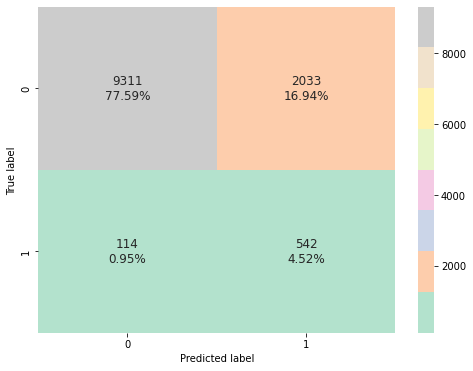

In [198]:
confusion_matrix_sklearn(rf_tuned2,  x_val,y_val)

- The best parameters for the given option to Ramdomized Search are number of trees 100, impurity decrease 0.05 and maximun number of columns 0.1.
- We managed to control the overfitting, but precision now is really giving a bad indication. Even if this is not our main goal, we need a balanced model to control the overall operational cost and with such a bad precision the model is not going to classify well the good turbines, so it will lead to unnecessary inspections.
- This model is giving us more error of both type I and type II than the other models, it will lead to misclassifications of good and bad turbines. We can see how 16.9% of the data is misclassified as bad turbines when they are actually working well.

## c.Tuning Bagging model with oversampled data

In [457]:
%%time
# defining model
Model_bag = BaggingClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV

param_grid = { 'max_samples': [0.8,0.9,1], 'max_features': [0.7,0.8,0.9], 'n_estimators' : [30,50,70], }
#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model_bag , param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=5, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(x_train_over,y_train_over)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'n_estimators': 70, 'max_samples': 1, 'max_features': 0.8} with CV score=1.0:
Wall time: 17min 7s


In [126]:
bag_tuned = BaggingClassifier(random_state=1,n_estimators= 70, max_samples= 1, max_features= 0.8)
bag_tuned.fit(x_train_over,y_train_over)

BaggingClassifier(max_features=0.8, max_samples=1, n_estimators=70,
                  random_state=1)

In [374]:
bag_train=model_performance_classification_sklearn(bag_tuned, x_train_over,y_train_over)
bag_train

,Accuracy,Recall,Precision,F1
0,0.500,1.000,0.500,0.667


In [373]:
bag_val=model_performance_classification_sklearn(bag_tuned, x_val,y_val)
bag_val

,Accuracy,Recall,Precision,F1
0,0.055,1.000,0.055,0.104


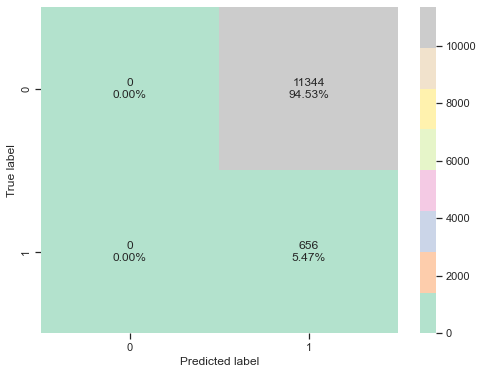

In [375]:
confusion_matrix_sklearn(bag_tuned,  x_val,y_val)

- The parameters we are selected by the RamdomizedSearch tool are maximum of tree, that is 70, and maximum features 80 percent of the columns and it seems to give a very high cross validation recall.
- The model results are very bad for the other metrics, especially for the validation set.
- When checking the confusion matrix for the validation set, there is not misclassification for the dominant class 0 because all of them are misclassified as damaged turbines.
-This model is one of the ones with worst results even if the recall is higher because it is not doing a good job classifying data.



## d.Tuning Gradient boosting with oversampled data
We have created two differente gradient boosting models to try to improve the models through the tuning process.

### Model GB_tuned

In [487]:
%%time
#defining model
Model_GB=GradientBoostingClassifier(random_state=1)
# Parameter grid to pass in RandomSearchCV

param_grid = { "n_estimators": np.arange(100,150,25), "learning_rate": [0.2, 0.05, 1], "subsample":[0.5,0.7], "max_features":[0.5,0.7] }
#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model_GB , param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=5, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(x_train_over,y_train_over)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'subsample': 0.7, 'n_estimators': 125, 'max_features': 0.5, 'learning_rate': 1} with CV score=0.9584041364195649:
Wall time: 6min 38s


In [129]:
#fitting model with best parameters
GB_tuned = GradientBoostingClassifier(random_state=1,subsample= 0.7, n_estimators=125, max_features= 0.5, learning_rate= 1)
GB_tuned.fit(x_train_over,y_train_over)

GradientBoostingClassifier(learning_rate=1, max_features=0.5, n_estimators=125,
                           random_state=1, subsample=0.7)

In [223]:
gb_train=model_performance_classification_sklearn(GB_tuned, x_train_over,y_train_over)
gb_train

,Accuracy,Recall,Precision,F1
0,0.983,0.980,0.986,0.983


In [224]:
gb_val=model_performance_classification_sklearn(GB_tuned, x_val,y_val)
gb_val

,Accuracy,Recall,Precision,F1
0,0.964,0.860,0.626,0.724


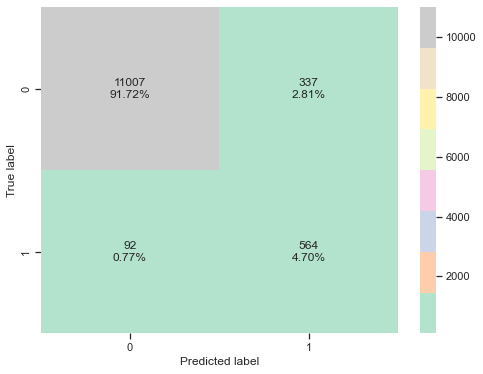

In [567]:
confusion_matrix_sklearn(GB_tuned,  x_val,y_val)

- This model best parameters according to Randomized search are 125 trees, 50 per cent of the features selected for each sample and a high learning rate.
-As result of this parameters selection our model recall score is very good, but precision score is low. Accuracy is very good as well in both sets.
- When checking the confusion matrix, some of the previous models had less classification errors for bad and good turbines.



### Model GB_tuned2

In [95]:
%%time
#defining model
Model_GB2=GradientBoostingClassifier(random_state=1)
# Parameter grid to pass in RandomSearchCV

param_grid = { "n_estimators": np.arange(100,150,25), "learning_rate": [0.01, 0.05,0.001], "subsample":[0.5,0.7,0.1] }
#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model_GB2 , param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=5, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(x_train_over,y_train_over)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'subsample': 0.7, 'n_estimators': 125, 'learning_rate': 0.05} with CV score=0.9109147585776481:
Wall time: 10min 45s


In [112]:
#fitting model with best parameters
GB_tuned2 = GradientBoostingClassifier(random_state=1,subsample= 0.7, n_estimators= 125, learning_rate= 0.05)
GB_tuned2.fit(x_train_over,y_train_over)

GradientBoostingClassifier(learning_rate=0.05, n_estimators=125, random_state=1,
                           subsample=0.7)

In [225]:
gb_train2=model_performance_classification_sklearn(GB_tuned2, x_train_over,y_train_over)
gb_train2

,Accuracy,Recall,Precision,F1
0,0.936,0.912,0.959,0.935


In [226]:
gb_val2=model_performance_classification_sklearn(GB_tuned2, x_val,y_val)
gb_val2

,Accuracy,Recall,Precision,F1
0,0.956,0.864,0.566,0.684


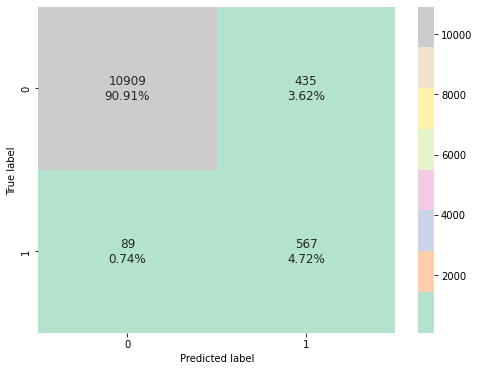

In [107]:
confusion_matrix_sklearn(GB_tuned2,  x_val,y_val)

- XGB_tuned2 parameters selected are similar to the previous model but learning rate is smaller, only 0.05. Number of trees used to build the model are 125.
- When checking performance of the model, accuracy and recall are very good but the model seems to be overfitted because the train model precision and F1 score is considerably better on train set.
-Confusion matrix also indicate that the misclassification for good turbines happens more often than the one for damaged turbines, what is good for our goal. Still previous models had less misclassification errors for both classes.


## e.Logistic Regression with L2 Regularization in oversampled data


In [510]:


%%time
#defining model
Model_lg=LogisticRegression(random_state=1, solver='saga')
# Parameter grid to pass in RandomSearchCV

param_grid = {'C':np.arange(0.1,1.1,0.1)}
randomized_cv = RandomizedSearchCV(estimator=Model_lg, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=5, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(x_train_over,y_train_over)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'C': 0.2} with CV score=0.8750993517680328:
Wall time: 48.6 s


In [132]:
lg_tuned=LogisticRegression(random_state=1, solver='saga',C= 0.2)
lg_tuned.fit(x_train_over, y_train_over)

LogisticRegression(C=0.2, random_state=1, solver='saga')

In [227]:
lg_train=model_performance_classification_sklearn(lg_tuned, x_train_over,y_train_over)
lg_train

,Accuracy,Recall,Precision,F1
0,0.874,0.875,0.873,0.874


In [228]:
lg_val=model_performance_classification_sklearn(lg_tuned, x_val,y_val)
lg_val

,Accuracy,Recall,Precision,F1
0,0.873,0.840,0.279,0.419


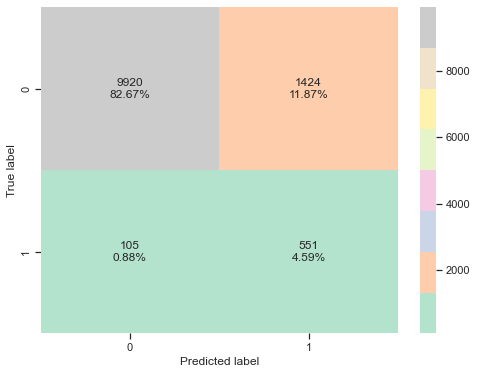

In [568]:
confusion_matrix_sklearn(lg_tuned,  x_val,y_val)


- Even though logistic regression was not the model with better cross validation score for oversampled data, we are trying to solve the overfitting problem and the C parameter provided on Logistic Regression models is helpful to help eliminate the curse of dimensionality that we seem to be facing.
- As expected, the model is not as overfitted but still train set performes better in general. Recall scored is acceptable but the precision is very low. 
- Confusion matrix shows a 11.5 percent of misclassification for the dominant class, class 0 and still higher type II error than other models as well.


## 8.Model performance comparison and choosing the final model

In [376]:
#Creating data frame to show the performance resuls for training data set
models_train_comp_df = pd.concat(
    [XGB_train3.T, XGB_train2.T, XGB_train.T, rf_train.T, rf_train2.T,bag_train.T,gb_train.T,gb_train2.T,lg_train.T],
    axis=1,
)
models_train_comp_df.columns = [
    'Model XGB_tuned3 ',
    'Model XGB_tuned2',
    'Model XGB_tuned ',
    'Model rf_tuned ',
    'Model rf_tuned2 ',
    'Model bag_tuned ',
    'Model gb_tuned',
    'Model gb_tuned2',
    'Model lg_tuned',
   
]


In [377]:
# Creating dataframe to show the performance results for all models on validations set

models_val_comp_df = pd.concat(
    [ XGB_val3.T, XGB_val2.T, XGB_val.T, rf_val.T,rf_val2.T,bag_val.T,gb_val.T,gb_val.T,lg_val.T], axis=1)


models_val_comp_df.columns = [
     'Model XGB_tuned3 ',
    'Model XGB_tuned2',
    'Model XGB_tuned ',
    'Model rf_tuned ',
    'Model rf_tuned2 ',
    'Model bag_tuned ',
    'Model gb_tuned',
    'Model gb_tuned2',
    'Model lg_tuned',
   
]


In [378]:
print("Training performance comparison:")
models_train_comp_df.T
models_train_comp_df.T

Training performance comparison:


,Accuracy,Recall,Precision,F1
Model XGB_tuned3,0.987,0.978,0.996,0.987
Model XGB_tuned2,0.997,1.000,0.993,0.997
Model XGB_tuned,0.991,1.000,0.982,0.991
Model rf_tuned,1.000,1.000,1.000,1.000
Model rf_tuned2,0.838,0.858,0.825,0.841
Model bag_tuned,0.500,1.000,0.500,0.667
Model gb_tuned,0.983,0.980,0.986,0.983
Model gb_tuned2,0.936,0.912,0.959,0.935
Model lg_tuned,0.874,0.875,0.873,0.874


In [379]:
print("validation performance comparison:")
models_val_comp_df.T

validation performance comparison:


,Accuracy,Recall,Precision,F1
Model XGB_tuned3,0.988,0.883,0.889,0.886
Model XGB_tuned2,0.978,0.892,0.753,0.816
Model XGB_tuned,0.968,0.898,0.647,0.752
Model rf_tuned,0.990,0.866,0.947,0.904
Model rf_tuned2,0.821,0.826,0.210,0.335
Model bag_tuned,0.055,1.000,0.055,0.104
Model gb_tuned,0.964,0.860,0.626,0.724
Model gb_tuned2,0.964,0.860,0.626,0.724
Model lg_tuned,0.873,0.840,0.279,0.419


- After a thorough analysis of the models, the one that shows less signs of overfitting is Model XGB_tuned3, since we use  reg_lambda to solve the overfitting. The Recall is a bit lower than XGB_tuned but precision and F1 score are much higher and the performance among train and test set are closer than in other models.
- So even if our priority is recall, are looking for some balance in the metric scores. Also a better precision will decrease the maintenance cost of the turbines.
- We need a model that can survive in production so the model XGB_tuned3 and we managed to decresed overfitting by tuning the xgb model.

## 9.Test set final performance

In [392]:
 model_performance_classification_sklearn(XGB_tuned3, x_train, y_train)

,Accuracy,Recall,Precision,F1
0,0.995,0.979,0.934,0.956


In [235]:
 model_performance_classification_sklearn(XGB_tuned3, x_test, y_test)

,Accuracy,Recall,Precision,F1
0,0.986,0.867,0.868,0.867


The XGB_tuned3 is a good model because it manages to decrease the cost of turbines failure reparation and also the cost of unscheduled inspection for the turbines that work well and were misclassified.

## 10 Pipelines to build the final model


In [157]:
#we make a copy of data frame df to create the pipe
df_train_pipe=df.copy()


In [158]:
#make a copy of the test data
df_test_pipe=df_test.copy()


In [159]:
#split train data in x predictors and y target
x_trainp=df_train_pipe.drop('Target',axis=1)
y_trainp=df_train_pipe['Target']


In [160]:
# split data in train and validation set 70:30 ratio and stratify to fix imbalanced data
x_trainp, y_trainp,x_testp,y_testp= train_test_split(x_pipe,y_pipe,test_size= 0.3,stratify=y_pipe)

In [161]:
#split test data in x predictors and y target
x_testp=df_test_pipe.drop('Target',axis=1)
y_testp=df_test_pipe['Target']


**PreProcessing train data**

In [162]:
#imputing null values with median of each column for train data 
imputerp=SimpleImputer(strategy='median')
x_trainp=imputerp.fit_transform(x_trainp)

In [163]:
#Oversampling to deal with imbalanced classed on the data we create synthetic data.
smote = SMOTE(sampling_strategy=1, k_neighbors=5, random_state=1)
x_train_overp, y_train_overp= smote.fit_resample(x_trainp, y_train)


**PreProcessin test data**

In [102]:

#imputing null values with median of each column for train data 
imputerp=SimpleImputer(strategy='median')
x_testp=imputerp.fit_transform(x_testp)

In [147]:
# best model classifier
best_model= XGBClassifier(random_state=1,eval_metric='logloss',n_estimators= 150, max_depth= 6, reg_lambda= 0.9, gamma= 5, eta= 0.1)
)

In [179]:
##creating pipeline for the best model and assignming name to the pipeline MOdel to fit the x_train set
Model=Pipeline(steps=[('imputerp',imputerp),('best_model',best_model)]).fit(x_train_overp, y_train_overp)

In [177]:
Model.fit(x_train_overp, y_train_overp)

Pipeline(steps=[('imputerp', SimpleImputer(strategy='median')),
                ('best_model',
                 XGBClassifier(base_score=0.5, booster='gbtree',
                               colsample_bylevel=1, colsample_bynode=1,
                               colsample_bytree=1, enable_categorical=False,
                               eta=0.1, eval_metric='logloss', gamma=5,
                               gpu_id=-1, importance_type=None,
                               interaction_constraints='',
                               learning_rate=0.100000001, max_delta_step=0,
                               max_depth=6, min_child_weight=1, missing=nan,
                               monotone_constraints='()', n_estimators=150,
                               n_jobs=8, num_parallel_tree=1, predictor='auto',
                               random_state=1, reg_alpha=0, reg_lambda=0.9,
                               scale_pos_weight=1, subsample=1,
                               tree_method='exa

In [181]:
prediction=Model.predict(x_testp)


In [186]:
#Looking at the number of turbines that are supposed to fail.
pd.Series(prediction).value_counts()

0    7281
1    2719
dtype: int64

In [189]:
#Lets check the damaged turbines in percentage
pd.Series(prediction).value_counts(normalize=True)*100

0   72.810
1   27.190
dtype: float64

- According to our model, we can expect 2719 turbines to fail from our test data. This is aa bing number. According to our prediction, 27 percent fo the turbines will have to be repair.


Pipeline steps:

In the intermideate steps of the pipeline, we can only add processes that required Fit_transform(), that is why oversampling is not included in the pipeline.
- Imputing missing values with SimpleImputer
- building the best model classifier with XGBoosting classifier
- fitting the model on train data
- using predict on test data

### 11 FINAL MODEL

In [393]:
# importance of features of GB model

print(
    pd.DataFrame(
      (XGB_tuned3.feature_importances_)*100, columns=["Imp"], index=x_train_over.columns
    ).sort_values(by="Imp", ascending=False).T
)#create data frame to show the importance of each feature of the modelin descending order

       V18    V36   V39   V26   V16    V3   V10   V14    V9   V11   V12   V30  \
Imp 15.978 10.304 8.542 6.318 4.907 4.355 3.823 3.375 2.695 2.350 2.159 2.086   

      V35   V34   V21   V38   V15   V24   V23   V27   V13   V37   V32    V1  \
Imp 1.945 1.912 1.829 1.668 1.549 1.471 1.359 1.331 1.329 1.284 1.259 1.197   

      V25    V6   V29    V4   V33   V31    V7   V28    V5   V40   V22   V19  \
Imp 1.195 1.119 1.107 1.004 0.992 0.983 0.968 0.938 0.933 0.923 0.885 0.827   

       V2   V17   V20    V8  
Imp 0.815 0.800 0.771 0.714  


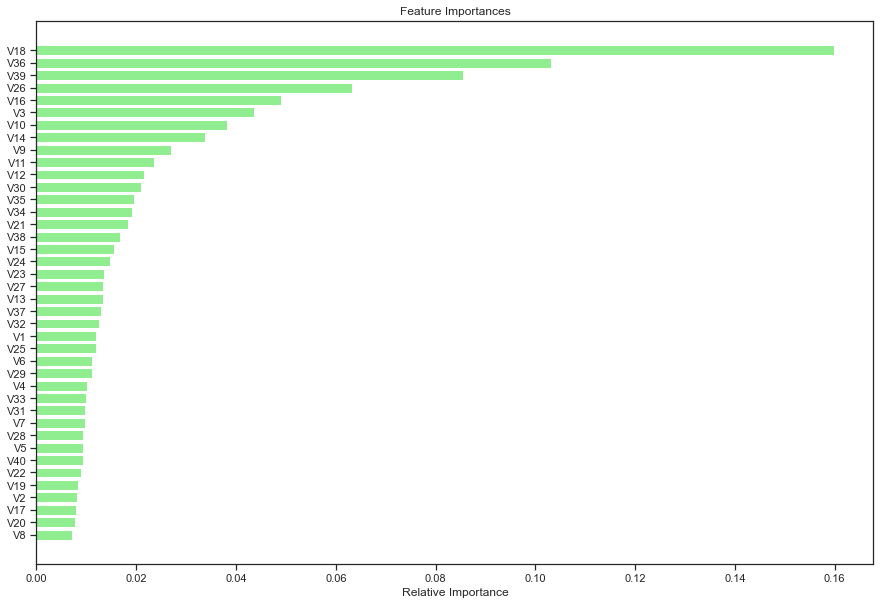

In [394]:
#plotting models importance features in descending order
feature_names = x_train_over.columns
importances = XGB_tuned3.feature_importances_#create importances of the model
indices = np.argsort(importances)#set descending order

plt.figure(figsize=(15,10))
plt.title('Feature Importances')#features relevant on GB model
plt.barh(range(len(indices)), importances[indices], color='lightgreen', align='center')#create horizontal bars and assign length to each of the bars
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])#assign names for the features on y axis
plt.xlabel('Relative Importance')#title
plt.show()

**Observation**

Since we do not know much about the features of the model, we can only provide the weight and contribution to each of the variables to the model or turbine failure detention.
- All variables contribute to the model in different proportion. Listed above is the rank of the variables in descending order according to their weights (in percentage) to the model contribution.
- The main features that can help us to predict the turbine failure are:
* The main variables are: v18 with 15% of the contribution followed by v36 with 10.3% ,v39 with 8.5% and v26 with 6.3%
* Features v16 and v3 contribute with a bit more than 4% each.


## 12.Business Insights and Conclusions

Wind power is a clean source of energy and one of the fastest growing around the world.
Despite the effort to improve the turbines during the latest decade, the sector is still facing challenges related to the nature of the wind energy production.

Below are listed some of the main challenges:

- There are many operational costs associated to the wind energy sector and energy is not as cost effective as the other types of energy. Turbine reparation is very costly, because usually they are in remote areas (wind farms) and it takes time to access the turbines to repair them.

- Turbine downtimes are one of the main reasons for the high operational cost. A turbine life is supposed to be twenty years but as they get older the cost of reparation increases and they hardly ever finish their life cycle.

- The best way to deal with turbine breakage is to prevent it. Wind power and turbines are constantly monitored but further techniques such as modeling are limited because of the lack of standardized data in the industry.

- The industry data is limited and as the sector is evaluating constantly, new turbines mechanism and components differ considerably from the older turbines. Most of the available information is based on the oldest ones, but it is very difficult to generalize due to the particularity of each turbine.

- The model XGB_tuned3 manages to find the variables that can classify defected turbines from the good ones, but due to the quality of the data and the fact that most of the information was ciphered, the analysis and the model prediction power is limited.

Definitely we could evaluate and improve our model in the future if more information is available for from the wind power industry study. Our data set may contain information of old and high-end turbines that work completely differently. A proper approach would be to separate data according to their components and the year each turbine was installed for first time, so we could create separate models adapted to each type of turbine with better prediction-classification power. 
